# Вспомогательный код

Установка необходимых библиотек:

In [1]:
!pip install -q lightning==2.5.0 tbparse

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 40.4/40.4 kB 2.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 815.3/815.3 kB 25.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 65.5/65.5 kB 4.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 983.2/983.2 kB 49.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 831.6/831.6 kB 45.4 MB/s eta 0:00:00


Чтобы результаты экспериментов воспроизводились, зафиксируем seeds:

In [2]:
import torch
import random
import numpy as np
import lightning as L


def set_random_seed(seed):
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False
    np.random.seed(seed)
    random.seed(seed)
    L.seed_everything(seed)


set_random_seed(42)

INFO: Seed set to 42
INFO:lightning.fabric.utilities.seed:Seed set to 42


Для выполнения задания рекомендуется использовать среду с аппаратным ускорителем GPU.

In [3]:
device = "cuda" if torch.cuda.is_available() else "cpu"
print(f"Using {device} device")

Using cuda device


# Задание 1. Прогнозирование временного ряда

Используя код из лекции, попробуйте обучить GRU с размерностью скрытого состояния `hidden_size=20` на следующих периодичных данных и визуализируйте результат.

## Формат результата

1. Графики предсказания модели:
- для обучающих и валидационных данных в режиме "forced prediction",
- для тестовых данных в режиме "rolling prediction".

Пример графиков:

<img src ="https://edunet.kea.su/repo/EduNet-web_dependencies/dev-2.4/Exercises/EX09/result_1_1_task_ex09.png" width="800">

2. Оценка качества предсказаний, полученных в режимах, описанных выше, для обучающих, валидационных и тестовых данных.

3. Графики предсказания модели для обучающих, валидационных и тестовых данных в режиме "rolling prediction". Для тестовых данных получить предсказание как минимум еще на одну длину тестовых данных.

Пример графиков:

<img src ="https://edunet.kea.su/repo/EduNet-web_dependencies/dev-2.4/Exercises/EX09/result_2_1_task_ex09.png" width="800">

Импорт необходимых библиотек:

In [ ]:
import os
import math
import torch
import random
import numpy as np
import pandas as pd
import torch.nn as nn
import matplotlib.pyplot as plt

from sklearn.metrics import mean_squared_error
from sklearn.metrics import root_mean_squared_error
from torch.utils.data import Dataset, DataLoader
from sklearn.linear_model import LinearRegression

Генерация данных для прогнозирования:

In [ ]:
data = []
total_length = 1000
for i in range(total_length):
    data.append(
        math.sin(i / 2) + math.cos((i) / 6) + i / 100 + (random.random() - 0.5) / 2
    )

dataset = pd.DataFrame(data={"timestamps": range(total_length), "values": data})
dataset.head()

,timestamps,values
0,0,1.069713
1,1,1.238074
2,2,1.693943
3,3,1.766683
4,4,1.853420


Выведем временной ряд:

In [ ]:
def simple_display(data, xticks, label=None):
    plt.figure(figsize=(12, 4))
    plt.plot(xticks, data, label=label)
    plt.legend()
    plt.grid()
    plt.show()

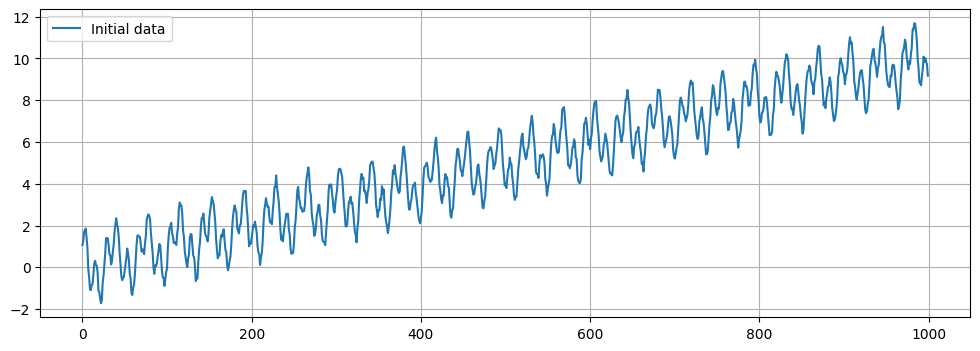

In [ ]:
data = dataset["values"]
simple_display(data=data, xticks=dataset["timestamps"], label="Initial data")

Пользуясь примером прогнозирования временного ряда с помощью рекуррентной нейронной сети из лекции, постройте прогнозирующую модель.

Шаги, которые необходимо совершить:
1. Разбиение на train-val-test.
2. Предобработка данных.
3. Создание и обучение модели.
4. Получение предсказаний и расчет метрик качества.

In [ ]:
len(data)

1000

In [ ]:
train_val_split=0.8
val_test_split = 0.5
trainset = dataset[:int(train_val_split*total_length)]
valset = dataset[int(train_val_split*total_length):int(train_val_split*total_length + (1-train_val_split)*total_length*val_test_split)]
testset = dataset[int(train_val_split*total_length + (1-train_val_split)*total_length*val_test_split):]

In [ ]:
split = {"train": {}, "val": {}, "test": {}}

for part, data_part in zip(split, [trainset, valset, testset]):
    split[part]["timestamps"] = data_part["timestamps"].values
    split[part]["data"] = data_part["values"].values

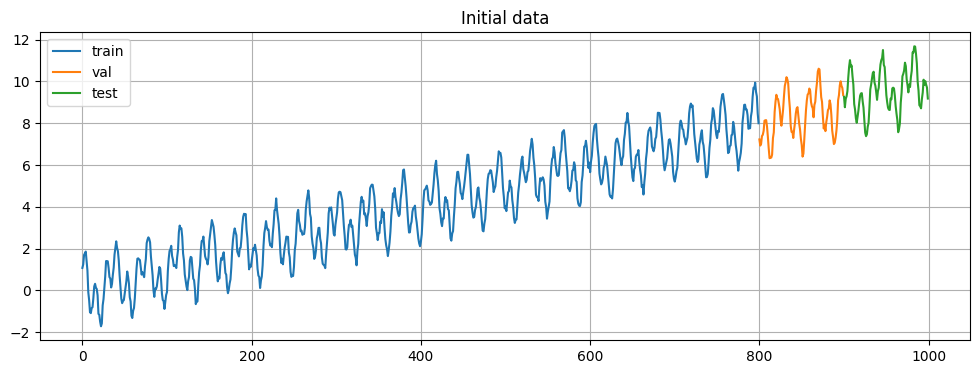

In [ ]:
def initial_data_display(split):
    plt.figure(figsize=(12, 4))
    for part in split:
        plt.plot(split[part]["timestamps"], split[part]["data"], label=part)
    plt.title("Initial data")
    plt.legend()
    plt.grid()
    plt.show()


initial_data_display(split)

In [ ]:
from sklearn.linear_model import LinearRegression


class TimeSeriesTransform:
    def __init__(self, apply_log=False):
        self.slope = None
        self.apply_log = apply_log

    def fit(self, train_data: np.ndarray):
        data = train_data
        if self.apply_log:
            data = np.log(data + 1)

        x = np.arange(len(data))
        x_centered = x - x.mean()

        data_centered = data - data.mean()


        reg = LinearRegression(fit_intercept=False).fit(
            x_centered.reshape(-1, 1), data_centered.reshape(-1, 1)
        )

        self.slope = reg.coef_[0]

        return self

    def transform(self, data: np.ndarray, window_size: int):
        if self.slope is None:
            raise ValueError("call fit before transform")

        if self.apply_log:
            data = np.log(data + 1)

        x = np.arange(len(data))
        x_centered = x - x.mean()
        trend = self.slope * x_centered

        anchor_value = data[window_size]
        data_centered = data - data.mean()
        data_detrended = data_centered - trend
        return anchor_value, data_detrended

    def inverse_transform(self, anchor_value: float, data_detrended: np.ndarray):
        if self.slope is None:
            raise ValueError("call fit before inverse_transform")

        x = np.arange(len(data_detrended))
        x_centered = x - x.mean()
        trend = self.slope * x_centered

        data = data_detrended + trend
        data = data - data[0] + anchor_value
        if self.apply_log:
            data = np.exp(data) - 1
        return data

In [ ]:
window_size = 12

split["train"]["transform"] = TimeSeriesTransform(apply_log=False)

split["train"]["transform"].fit(split["train"]["data"])

for part in split:
    split[part]["anchor_value"], split[part]["data_transformed"] = split["train"][
        "transform"
    ].transform(split[part]["data"], window_size=window_size)

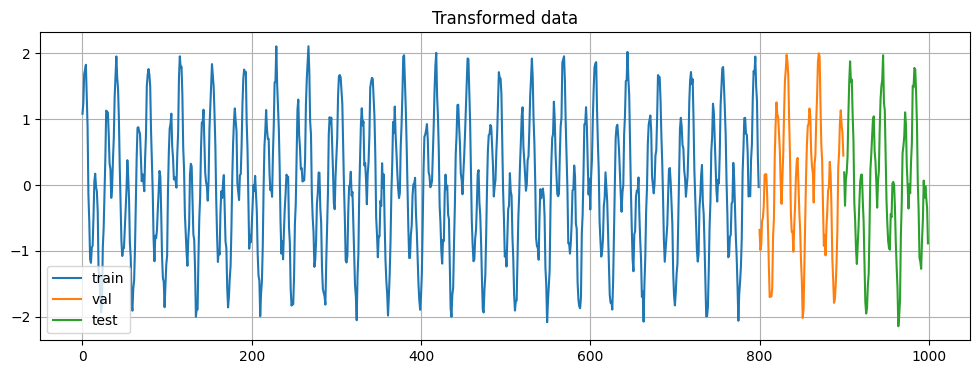

In [ ]:
def transformed_data_display(split):
    plt.figure(figsize=(12, 4))
    for part in split:
        plt.plot(split[part]["timestamps"], split[part]["data_transformed"], label=part)
    plt.title("Transformed data")
    plt.legend()
    plt.grid()
    plt.show()


transformed_data_display(split)

In [ ]:
import torch
from torch.utils.data import Dataset


class TimeSeriesDataset(Dataset):
    def __init__(self, data, seq_length):
        super().__init__()
        self.seq_length = seq_length
        self.data = torch.from_numpy(data).float()

    def __getitem__(self, idx):
        # seq_len elements input
        x = self.data[idx : (idx + self.seq_length)].view(-1, 1)
        # one element output
        y = self.data[idx + self.seq_length]
        return x, y

    def __len__(self):
        return len(self.data) - self.seq_length

In [ ]:
from torch.utils.data import DataLoader

for part in split:
    split[part]["dataset"] = TimeSeriesDataset(
        data=split[part]["data_transformed"], seq_length=window_size
    )

    shuffle = True if part == "train" else False

    split[part]["dataloader"] = DataLoader(
        dataset=split[part]["dataset"], batch_size=16, shuffle=shuffle
    )

In [ ]:

class TimeSeriesPredictor(nn.Module):
    def __init__(self, input_size=1, hidden_size=16):
        # hidden_size it is number of hidden neurons
        super().__init__()
        self.rnn = nn.RNN(
            input_size=input_size, hidden_size=hidden_size, batch_first=True
        )
        # Predict only one value
        self.fc = nn.Linear(hidden_size, 1)

    def forward(self, x):
        # x shape: [b_s, seq_len, input_size]  b_s <= batch_size
        out, h = self.rnn(x)  # [b_s, seq_len, hidden_size], [1, b_s, hidden_size]
        y = self.fc(h)  # [1, b_s, 1]
        y = y.flatten()  # [b_s]
        return y

In [ ]:
def forced_predict(model, split, part):
    y_true = []
    y_pred = []
    model.eval()
    dataset = split[part]["dataset"]
    with torch.no_grad():
        for x, y in dataset:
            out = model(x.unsqueeze(0))
            y_true.append(y.item())
            y_pred.append(out.item())
    y_true = np.array(y_true)
    y_pred = np.array(y_pred)

    transform = split["train"]["transform"]
    y_true = transform.inverse_transform(split[part]["anchor_value"], y_true)
    y_pred = transform.inverse_transform(split[part]["anchor_value"], y_pred)

    return y_true, y_pred

def rolling_predict(model, split, part, forecast_horizon):
    y_pred = []
    model.eval()
    dataset = split[part]["dataset"]
    x, _ = dataset[0]

    with torch.no_grad():
        for _ in range(forecast_horizon):
            out = model(x.unsqueeze(0)).view(-1, 1)
            y_pred.append(out.item())
            x = torch.cat([x[1:], out])
    y_pred = np.array(y_pred)

    transform = split["train"]["transform"]
    y_pred = transform.inverse_transform(split[part]["anchor_value"], y_pred)

    return y_pred

In [ ]:
import lightning as L
from torchmetrics import MetricCollection
from torchmetrics.regression import MeanSquaredError


class TimeSeriesPipeline(L.LightningModule):
    def __init__(
        self,
        model,
        exp_name="baseline",
        criterion=nn.MSELoss(),
        optimizer_class=torch.optim.Adam,
    ):
        super().__init__()
        self.model = model
        self.criterion = criterion
        self.optimizer_class = optimizer_class
        metrics = MetricCollection([MeanSquaredError()])
        self.train_metrics = metrics.clone(postfix="/train")
        self.valid_metrics = metrics.clone(postfix="/val")

    def configure_optimizers(self):
        optimizer = self.optimizer_class(self.model.parameters())
        return optimizer

    def training_step(self, batch, batch_idx):
        x, y = batch
        out = self.model(x)
        loss = self.criterion(out.squeeze(-1),y)

        self.log("Loss/train", loss, prog_bar=True)
        self.train_metrics.update(out.squeeze(-1), y)

        return loss

    def validation_step(self, batch, batch_idx):
        x, y = batch
        out = self.model(x)
        loss = self.criterion(out.squeeze(-1), y)
        self.log("Loss/val", loss, prog_bar=True)
        self.valid_metrics.update(out.squeeze(-1), y)

    def on_training_epoch_end(self):
        train_metrics = self.train_metrics.compute()
        self.log_dict(train_metrics)
        self.train_metrics.reset()

    def on_validation_epoch_end(self):
        valid_metrics = self.valid_metrics.compute()
        self.log_dict(valid_metrics)
        self.valid_metrics.reset()

In [ ]:
class SimpleGRU(nn.Module):
    def __init__(self, input_size, hidden_size):
        super().__init__()
        self.gru = nn.GRU(
            input_size=input_size, hidden_size=hidden_size, batch_first=True
        )

        self.fc1 = nn.Linear(hidden_size, hidden_size//2)
        self.fc2 = nn.Linear(hidden_size//2,1)
        self.activation = nn.ReLU()

    def forward(self, x):
        out, _ = self.gru(x)
        out = self.activation(self.fc1(out[:, -1, :]))
        out = self.fc2(out)
        return out

In [ ]:
from lightning.pytorch import Trainer
from lightning.pytorch.callbacks import ModelCheckpoint
from lightning.pytorch.loggers import TensorBoardLogger


L.seed_everything(42)

checkpoint_callback = ModelCheckpoint(
    monitor="MeanSquaredError/val", mode="min", filename="best"
)

exp_name = f"baseline"
trainer = Trainer(
    max_epochs=400,
    logger=TensorBoardLogger(save_dir=f"logs/ex", name=exp_name),
    num_sanity_val_steps=1,
    callbacks=[checkpoint_callback],
    log_every_n_steps=5,
    enable_progress_bar=False,
)



pipeline = TimeSeriesPipeline(
    model=SimpleGRU(1,128),
    optimizer_class=torch.optim.Adam,
)

trainer.fit(
    model=pipeline,
    train_dataloaders=split["train"]["dataloader"],
    val_dataloaders=split["val"]["dataloader"],
)

INFO: Seed set to 42
INFO:lightning.fabric.utilities.seed:Seed set to 42
INFO: GPU available: True (cuda), used: True
INFO:lightning.pytorch.utilities.rank_zero:GPU available: True (cuda), used: True
INFO: TPU available: False, using: 0 TPU cores
INFO:lightning.pytorch.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO: HPU available: False, using: 0 HPUs
INFO:lightning.pytorch.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO: 
  | Name          | Type             | Params | Mode 
-----------------------------------------------------------
0 | model         | SimpleGRU        | 58.6 K | train
1 | criterion     | MSELoss          | 0      | train
2 | train_metrics | MetricCollection | 0      | train
3 | valid_metrics | MetricCollection | 0      | train
-----------------------------------------------------------
58.6 K    Trainable 

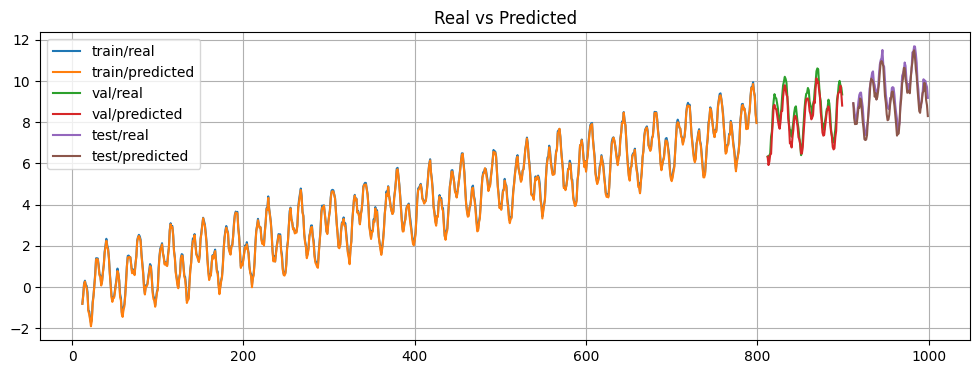

In [ ]:
def display_pred_with_rolling_test(split):
    plt.figure(figsize=(12, 4))
    for part in split:
        timestamps = split[part]["timestamps"][window_size:]
        real_data = split[part]["y_true"]
        pred_data = split[part]["y_pred"]

        if part in ("train", "val"):

            plt.plot(timestamps, real_data, label=f"{part}/real")
            plt.plot(timestamps, pred_data, label=f"{part}/predicted")

        if part == "test":
            plt.plot(timestamps, real_data, label=f"{part}/real")
            future_timestamps = np.arange(
                timestamps[0], len(pred_data) + timestamps[0]
            )
            plt.plot(future_timestamps, pred_data, label=f"{part}/predicted")

    plt.title("Real vs Predicted")
    plt.legend()
    plt.grid()
    plt.show()

model = pipeline.model
for part in split:
    if part in ("train", "val"):
        y_true, y_pred = forced_predict(model,split,part)

    if part == "test":
        y_true, _ = forced_predict(model, split, part)
        y_pred = rolling_predict(model, split,part,forecast_horizon=len(y_true))

    split[part]["y_true"] = y_true
    split[part]["y_pred"] = y_pred

display_pred_with_rolling_test(split)

In [ ]:
from sklearn.metrics import root_mean_squared_error

for part in split:
    part_rmse = np.sqrt(
        root_mean_squared_error(
            y_true=split[part]["y_true"],
            y_pred=split[part]["y_pred"],
        )
    )
    print(f"{part:<5} RMSE: {part_rmse:.2f}")

train RMSE: 0.27
val   RMSE: 0.64
test  RMSE: 0.64


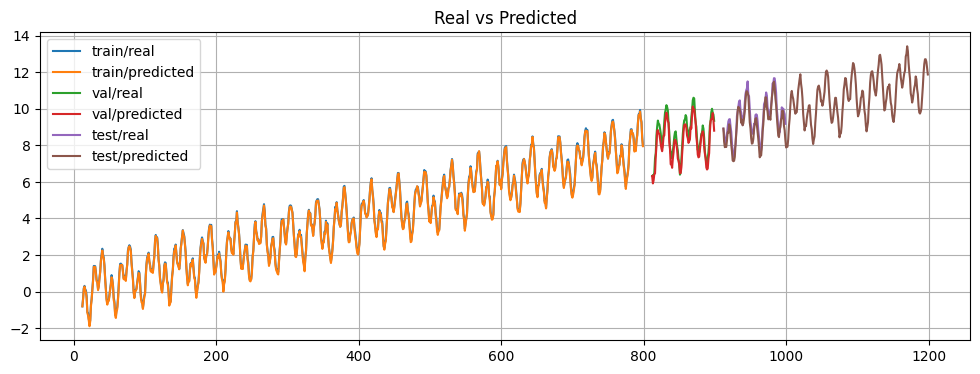

In [ ]:
model = pipeline.model
predict_next = 200
for part in split:
    if part in ("train", "val"):
        y_true, y_pred = forced_predict(model,split,part)

    if part == "test":
        y_true, _ = forced_predict(model, split, part)
        y_pred = rolling_predict(model, split,part,forecast_horizon=len(y_true)+predict_next)

    split[part]["y_true"] = y_true
    split[part]["y_pred"] = y_pred

display_pred_with_rolling_test(split)

# Задание 2. Sentiment analysis

В этом задании вам предлагается решить задачу классификации эмоциональной окрашенности отзывов на фильмы из базы данных [IMDB 🛠️[doc]](https://ai.stanford.edu/~amaas/data/sentiment/).

При решении задачи вы пройдете через несколько этапов предобработки текстовых данных, построите и обучите рекуррентную нейронную сеть на базе GRU и оцените качество ее работы. В задании также предлагается исследовать влияние двунаправленности обработки текста на точность решения задачи.

## Формат результата

0. Освоенные стадии базовой предобработки текстовых данных.
1. Пройденные assert-ы, расставленные вдоль всего задания.
2. Реализованная архитектура рекуррентной нейронной сети на базe GRU, обученная классифицировать отзывы с точностью&nbsp;>&nbsp;0.7.
3. Реализованная архитектура рекуррентной нейронной сети на базe GRU с двунаправленной обработкой текстов, обученная классифицировать отзывы с точностью&nbsp;>&nbsp;0.8.

Установка и импорт необходимых библиотек:

In [ ]:
from IPython.display import clear_output

!pip install -qU datasets==2.16.1
clear_output()

In [ ]:
import nltk
import string

import pandas as pd

from datasets import load_dataset
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer
from sklearn.model_selection import train_test_split

## Загрузка и изучение данных

Загрузим [датасет 🛠️[doc]](https://huggingface.co/datasets/stanfordnlp/imdb), в нем собраны отзывы на фильмы, размеченные на два класса: "positive" и "negative".

In [ ]:
imdb = load_dataset("imdb")
clear_output()
imdb

DatasetDict({
    train: Dataset({
        features: ['text', 'label'],
        num_rows: 25000
    })
    test: Dataset({
        features: ['text', 'label'],
        num_rows: 25000
    })
    unsupervised: Dataset({
        features: ['text', 'label'],
        num_rows: 50000
    })
})

Данные в датасете уже разделены на обучающие и тестовые (подвыборки `train` и `test`). Каждая подвыборка имеет признаки `text` и `label`. В каждой подвыборке содержится по 25000 отзывов.

В качестве тестовых данных будем использовать поставляемую в датасете подвыборку `test`, а из подвыборки `train` выделим пятую часть как валидационные данные.

In [ ]:
train_data, val_data, train_labels, val_labels = train_test_split(
    imdb["train"]["text"],
    imdb["train"]["label"],
    test_size=0.2,
    stratify=imdb["train"]["label"],
    random_state=42,
)

test_data, test_labels = imdb["test"]["text"], imdb["test"]["label"]

Соберем данные в датафреймы и выведем первые 5 отзывов обучающей выборки и их метки:

In [ ]:
df_train = pd.DataFrame({"text": train_data, "label": train_labels})

df_val = pd.DataFrame({"text": val_data, "label": val_labels})

df_test = pd.DataFrame({"text": test_data, "label": test_labels})

df_train.head()

,text,label
0,I have always been a huge James Bond fanatic! ...,1
1,I am a Christian and I say this movie had terr...,0
2,"Neatly sandwiched between THE STRANGER, a smal...",1
3,Years ago I did follow a soap on TV. So I was ...,1
4,"Here's a gritty, get-the-bad guys revenge stor...",1


Изучим распределение данных по классам и оценим баланс классов.

In [ ]:
for df in [df_train, df_val, df_test]:
    print(df["label"].value_counts())

label
1    10000
0    10000
Name: count, dtype: int64
label
1    2500
0    2500
Name: count, dtype: int64
label
0    12500
1    12500
Name: count, dtype: int64


Видим, что в выборке 2 класса и они сбалансированы. Значит нам не придется применять техники борьбы с дисбалансом, а в качестве целевой метрики качества можем использовать accuracy.

## Предобработка данных

Предобработка текстовых данных будет состоять из следующих шагов:
* приведение текстов отзывов к нижнему регистру
* удаление из отзывов знаков пунктуации и других спецсимволов
* разделение отзывов на отдельные слова (токенизация)
* удаление стоп-слов
* [лемматизация 📚[wiki]](https://ru.wikipedia.org/wiki/Лемматизация) слов
* составление словаря уникальных слов
* перевод отзыва из формата "последовательность слов" в формат "последовательность индексов слов согласно словарю"
* приведение отзывов к единой длине

"Классическим" инструментом обработки текстовых данных является библиотека [NLTK 🛠️[doc]](https://www.nltk.org/) (Natural Language Toolkit), и мы будем пользоваться ей.

### Приведение текстов к нижнему регистру

Применим лямбда-функцию с приведением текстов к нижнему регистру ко всем отзывам (будем постепенно предобрабатывать текст и обновлять результат в колонке `processed_text`):

In [ ]:
for df in [df_train, df_val, df_test]:
    df["processed_text"] = df["text"].apply(lambda text: text.lower())

df_train.head()

,text,label,processed_text
0,I have always been a huge James Bond fanatic! ...,1,i have always been a huge james bond fanatic! ...
1,I am a Christian and I say this movie had terr...,0,i am a christian and i say this movie had terr...
2,"Neatly sandwiched between THE STRANGER, a smal...",1,"neatly sandwiched between the stranger, a smal..."
3,Years ago I did follow a soap on TV. So I was ...,1,years ago i did follow a soap on tv. so i was ...
4,"Here's a gritty, get-the-bad guys revenge stor...",1,"here's a gritty, get-the-bad guys revenge stor..."


### Удаление знаков пунктуации и других спецсимволов

Напишем функцию `remove_punktuation` для удаления знаков пунктуации (с помощью `string.punctuation` [🛠️[doc]](https://docs.python.org/3/library/string.html#string.punctuation)) и цифр (проверка символа c помощью `str.isdigit()` [🛠️[doc]](https://docs.python.org/3/library/stdtypes.html#str.isdigit)) и применим ее ко всем отзывам.

In [ ]:
import string


def remove_punktuation(text):
    text = text.translate(str.maketrans("", "", string.punctuation))
    text = "".join([c for c in text if not c.isdigit()])
    return text


for df in [df_train, df_val, df_test]:
    df["processed_text"] = df["processed_text"].apply(remove_punktuation)

df_train.head()

,text,label,processed_text
0,I have always been a huge James Bond fanatic! ...,1,i have always been a huge james bond fanatic i...
1,I am a Christian and I say this movie had terr...,0,i am a christian and i say this movie had terr...
2,"Neatly sandwiched between THE STRANGER, a smal...",1,neatly sandwiched between the stranger a small...
3,Years ago I did follow a soap on TV. So I was ...,1,years ago i did follow a soap on tv so i was c...
4,"Here's a gritty, get-the-bad guys revenge stor...",1,heres a gritty getthebad guys revenge story st...


### Токенизация (разделение отзывов на отдельные слова)

В рамках этого задания мы будем рассматривать в качестве токенов отдельные слова, а не символы или части слов. Для такой токенизации в библиотеке NLTK есть функция `word_tokenize` [🛠️[doc]](https://www.nltk.org/api/nltk.tokenize.html#nltk.tokenize.word_tokenize). В результате ее применения отзыв переводится в список отдельных слов.

Применим функцию токенизации ко всем отзывам:

In [ ]:
import nltk
from nltk.tokenize import word_tokenize

# necessary addition to use word_tokenize
nltk.download("punkt_tab")

for df in [df_train, df_val, df_test]:
    df["processed_text"] = df["processed_text"].apply(lambda text: word_tokenize(text))

df_train.head()

[nltk_data] Downloading package punkt_tab to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt_tab.zip.


,text,label,processed_text
0,I have always been a huge James Bond fanatic! ...,1,"[i, have, always, been, a, huge, james, bond, ..."
1,I am a Christian and I say this movie had terr...,0,"[i, am, a, christian, and, i, say, this, movie..."
2,"Neatly sandwiched between THE STRANGER, a smal...",1,"[neatly, sandwiched, between, the, stranger, a..."
3,Years ago I did follow a soap on TV. So I was ...,1,"[years, ago, i, did, follow, a, soap, on, tv, ..."
4,"Here's a gritty, get-the-bad guys revenge stor...",1,"[heres, a, gritty, getthebad, guys, revenge, s..."


### Удаление стоп-слов

Стоп-слова — это шумовые слова, которые встречаются в каждом отзыве и не несут смысловой нагрузки с точки зрения решаемой задачи. В контексте нашей задачи это артикли, предлоги, союзы и т. п.

В библиотеке NLTK уже есть список стоп-слов для английского языка. Взглянем на него:

In [ ]:
from nltk.corpus import stopwords

# necessary addition to use stopwords
nltk.download("stopwords")

stop_words = set(stopwords.words("english"))
print(stop_words)

{"we're", "it'll", "they'll", 'hasn', "mustn't", 'such', 'on', 'i', 'under', 'wouldn', 'weren', "she'll", 'other', 'who', 'couldn', 'here', 'didn', "they're", 'she', 'will', 'ain', 'the', "doesn't", 'this', 'and', 'having', 'or', 'your', 'then', "you'll", "that'll", 'were', 'doing', 'if', "you'd", 'don', 've', "they've", 'where', 'had', 'her', 'myself', 'themselves', 'haven', 'mustn', "weren't", 'all', "haven't", 'what', "i'm", 'them', "wouldn't", 'doesn', 'most', 'through', 'an', 'ourselves', 'ma', "you've", 'below', 'for', 'yourselves', 'in', 'of', 'from', 'only', 'that', 'once', 'too', 'll', 'over', "hadn't", 'me', 'herself', "shouldn't", 'both', "hasn't", 'hadn', 'their', 'wasn', 'not', 'same', 'should', "he'll", 'than', 'own', "didn't", 'ours', 'some', 'which', 'mightn', 'theirs', 'o', 'these', "aren't", "isn't", 'shouldn', 'any', "you're", "they'd", 'into', "mightn't", "needn't", 'so', 'until', 'when', 'was', 'they', 'did', 'again', 'during', 'd', 'at', 'why', 'been', 'm', 'am', 

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


Отзывы в датасете были собраны с веб-сайта IMDB, и в текстах часто встречается HTML-тег `<br>`, который тоже следует удалить. Так как знаки пунктуации `<` и `>` мы уже устранили, остается только дополнить множесво стоп-слов словом `br`.

In [ ]:
stop_words.add("br")

Напишем функцию `remove_stop_words`, которая для отзыва в виде списка слов соберет новый список, в котором стоп-слова будут удалены.

In [ ]:
def remove_stop_words(words_list):
    return [word for word in words_list if word not in stop_words]


for df in [df_train, df_val, df_test]:
    df["processed_text"] = df["processed_text"].apply(remove_stop_words)

df_train.head()

,text,label,processed_text
0,I have always been a huge James Bond fanatic! ...,1,"[always, huge, james, bond, fanatic, seen, alm..."
1,I am a Christian and I say this movie had terr...,0,"[christian, say, movie, terrible, acting, unre..."
2,"Neatly sandwiched between THE STRANGER, a smal...",1,"[neatly, sandwiched, stranger, small, film, no..."
3,Years ago I did follow a soap on TV. So I was ...,1,"[years, ago, follow, soap, tv, curious, movie,..."
4,"Here's a gritty, get-the-bad guys revenge stor...",1,"[heres, gritty, getthebad, guys, revenge, stor..."


### Лемматизация

Лемматизация — процесс приведения словоформы к лемме — её нормальной (словарной) форме.

В библиотеке NLTK есть лемматизатор для английского языка — `WordNetLemmatizer`
[🛠️[doc]](https://www.nltk.org/api/nltk.stem.WordNetLemmatizer.html). Посмотрим, как он работает:

In [ ]:
from nltk.stem import WordNetLemmatizer

# necessary addition to use WordNetLemmatizer
nltk.download("wordnet")

lemmatizer = WordNetLemmatizer()

example_words = ["children", "broke", "closest"]
[lemmatizer.lemmatize(word) for word in example_words]

[nltk_data] Downloading package wordnet to /root/nltk_data...


['child', 'broke', 'closest']

Можно заметить, что лемматизация применилась только к существительному "children". По умолчанию параметр `pos` (part of speech) лемматизатора `WordNetLemmatizer` имеет значение `"n"` (noun). Другие возможные значения: `"v"` (verb) для глаголов, `"a"` (adjective) для прилагательных и `"r"` (adverb) для наречий.

In [ ]:
print(
    f'Lemma for word "{example_words[1]}" is "{lemmatizer.lemmatize(example_words[1], "v")}".'
)
print(
    f'Lemma for word "{example_words[2]}" is "{lemmatizer.lemmatize(example_words[2], "a")}".'
)

Lemma for word "broke" is "break".
Lemma for word "closest" is "close".


Метод `pos_tag()` позволяет автоматически определять часть речи для всех слов предложения, а также содержит дополнительную грамматическую информацию.

In [ ]:
nltk.download("averaged_perceptron_tagger_eng")
nltk.pos_tag(example_words)

[nltk_data] Downloading package averaged_perceptron_tagger_eng to
[nltk_data]     /root/nltk_data...
[nltk_data]   Unzipping taggers/averaged_perceptron_tagger_eng.zip.


[('children', 'NNS'), ('broke', 'VBD'), ('closest', 'JJS')]

Можно заметить, что частеречные теги лемматизатора и pos-теггера различаются. Напишем функцию, которая будет заменять теги pos-теггера на теги лемматизатора по словарю соответствия и возвращать для каждого токена аналогичный кортеж `(слово, тег)`.

In [ ]:
from nltk.corpus import wordnet


def pos_mapping(text):
    word_tag_array = []
    for word_tag in nltk.pos_tag(text):
        tag = word_tag[1][0]
        tag_dict = {"J": "a", "N": "n", "V": "v", "R": "r"}
        word_tag_array.append((word_tag[0], tag_dict.get(tag, wordnet.NOUN)))
    return word_tag_array


pos_mapping(example_words)

[('children', 'n'), ('broke', 'v'), ('closest', 'a')]

Теперь можем осуществить лемматизацию всех частей речи.

In [ ]:
[lemmatizer.lemmatize(word, tag) for word, tag in pos_mapping(example_words)]

['child', 'break', 'close']

Напишем функцию `lemmatize`, которая для каждого слова в отзыве произведет лемматизацию, и применим ее ко всем отзывам:

In [ ]:
def lemmatize(words_list):
    return [lemmatizer.lemmatize(word, tag) for word, tag in pos_mapping(words_list)]


for df in [df_train, df_val, df_test]:
    df["processed_text"] = df["processed_text"].apply(lemmatize)

df_train.head()

,text,label,processed_text
0,I have always been a huge James Bond fanatic! ...,1,"[always, huge, james, bond, fanatic, see, almo..."
1,I am a Christian and I say this movie had terr...,0,"[christian, say, movie, terrible, act, unreal,..."
2,"Neatly sandwiched between THE STRANGER, a smal...",1,"[neatly, sandwich, stranger, small, film, noir..."
3,Years ago I did follow a soap on TV. So I was ...,1,"[year, ago, follow, soap, tv, curious, movie, ..."
4,"Here's a gritty, get-the-bad guys revenge stor...",1,"[here, gritty, getthebad, guy, revenge, story,..."


## Создание словаря

Следующим этапом является создание словаря. Словарь — это индексированное множество уникальных слов в корпусе документов. Однако если просто составить множество уникальных слов, скорее всего его размер будет очень большим, и главное — в нем будут находиться очень редкие слова, которые встречаются во всем корпусе всего по одному-два раза.

Обычно поступают просто: включают в словарь слова, которые встречаются в корпусе хотя бы N раз, скажем 50. Это позволяет критически снизить размер словаря.

На самом деле, на текущем этапе мы уже косвенно повлияли на размер словаря за счет удаления стоп-слов и путем лемматизации, ведь при ней разные формы одного слова приводятся к одному виду и уникальных слов становится меньше.


Составьте список **всех** (не уникальных) слов в обучающей выборке. Для этого нужно просто сконкатенировать все отзывы в виде списков слов в обучающей выборке (`df_train['processed_text']`) в единый список `all_words`.

In [ ]:
df["processed_text"]

,processed_text
0,"[love, scifi, willing, put, lot, scifi, movies..."
1,"[worth, entertainment, value, rental, especial..."
2,"[totally, average, film, semialright, action, ..."
3,"[star, rating, saturday, night, friday, night,..."
4,"[first, let, say, havent, enjoy, van, damme, m..."
...,...
24995,"[get, around, see, monster, man, yesterday, lo..."
24996,"[get, part, competition, prize, watch, really,..."
24997,"[get, monster, man, box, set, three, film, mai..."
24998,"[five, minute, start, feel, naff, look, youve,..."


In [ ]:
all_words = []
for tokens in df_train['processed_text']:
    all_words.extend(tokens)

assert len(all_words) == 2406639, "Oops, something wrong!"
print("Total number of non-unique words in train corpus:", len(all_words))

Total number of non-unique words in train corpus: 2406639


Требуется включить в словарь только уникальные слова, которые встречаются в обучающей выборке хотя бы 50 раз. Для этого нам нужно их сосчитать. За этим можно обратиться к классу `Counter` [🛠️[doc]](https://docs.python.org/3/library/collections.html#collections.Counter).

In [ ]:
from collections import Counter

word_counts = Counter(all_words)
print("Counter object type:", type(word_counts))
print("Total number of unique words in train corpus:", len(word_counts))
print("Top most frequent words (word : number of occurrences):", word_counts)

Counter object type: <class 'collections.Counter'>
Total number of unique words in train corpus: 95550
Top most frequent words (word : number of occurrences): Counter({'movie': 39679, 'film': 36741, 'one': 21325, 'make': 17742, 'like': 17061, 'see': 16227, 'get': 14303, 'good': 13144, 'time': 11992, 'character': 10960, 'go': 10920, 'watch': 10456, 'well': 10187, 'even': 10114, 'story': 9918, 'bad': 9829, 'would': 9702, 'really': 9247, 'think': 8988, 'show': 8431, 'scene': 7974, 'great': 7704, 'much': 7653, 'look': 7611, 'say': 7553, 'people': 7390, 'end': 7278, 'also': 7230, 'know': 7125, 'first': 7068, 'give': 7060, 'take': 6880, 'dont': 6807, 'way': 6755, 'come': 6571, 'love': 6560, 'play': 6481, 'act': 6377, 'thing': 6369, 'find': 6223, 'could': 6149, 'seem': 5706, 'two': 5354, 'work': 5333, 'life': 5322, 'many': 5310, 'plot': 5253, 'actor': 5224, 'want': 5134, 'never': 5092, 'little': 5087, 'year': 5051, 'best': 5017, 'try': 4908, 'ever': 4629, 'still': 4465, 'man': 4438, 'part': 4

Теперь, используя счетчик слов, можно составить словарь и включить в него только слова, которые встречаются в обучающей выборке 50 раз и более. Используйте `word_counts.items()`.

In [ ]:
vocab =  {word: count for word, count in word_counts.items() if count >= 50}

assert len(vocab) == 5107, "Oops, something wrong!"
print("Vocabulary size:", len(vocab))

Vocabulary size: 5107


Кроме слов, нужно добавить в словарь пару специальных токенов:


*   Токен `<PAD>` — им мы будем дополнять отзывы, когда нам потребуется приводить их к единой длине,
*  Токен  `<UNK>` — если при обработке новых отзывов будут попадаться слова, не вошедшие в словарь, то на их месте будет этот токен.

Дополните словарь двумя специальными токенами.



In [ ]:
vocab["<PAD>"] = 0
vocab["<UNK>"] = 0

Позднее нам потребуется закодировать слова в числа. Для этого создайте словари (python dictionary):
* `word_to_id` для перевода слова в целочисленный номер
* `id_to_word` для обратного перевода номера слова в само слово

In [ ]:
word_to_id = {word: idx for idx, word in enumerate(vocab)}
id_to_word = {idx: word for word, idx in word_to_id.items()}

assert len(word_to_id) == len(vocab) == len(id_to_word), "Oops, something wrong!"
print("word_to_id and id_to_word mappers size:", len(vocab))

word_to_id and id_to_word mappers size: 5109


## Укорачивание длинных отзывов

Создайте массив `review_lengths` с длинами отзывов (в смысле количества слов) в обучающей выборке. Обращайтесь к `df_train["processed_text"]`.

 Выведите гистограмму распределения длины отзывов.

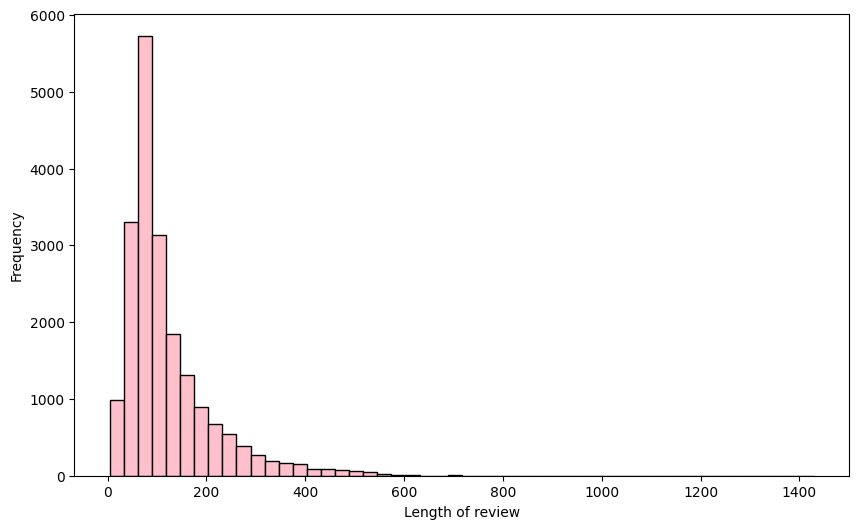

In [ ]:
import matplotlib.pyplot as plt

review_lengths = df_train["processed_text"].apply(len)


plt.figure(figsize=(10, 6))
plt.hist(review_lengths, bins=50, color='pink', edgecolor='black')
plt.xlabel("Length of review")
plt.ylabel("Frequency")
plt.show()

Видим, что распределение длин отзывов имеет длинный правый хвост. При обработке редких длинных отзывов рекуррентной нейронной сетью мы будем терять время, так как слова в RNN обрабатываются последовательно, а не параллельно. Предлагается укоротить длинные отзывы, введя ограничение на максимальную длину отзыва.

В качестве максимальной длины можно выбрать 95-й перцентиль выборки длин. Воспользуйтесь `numpy.percentile` [🛠️[doc]](https://numpy.org/doc/stable/reference/generated/numpy.percentile.html).

In [ ]:
max_length = int(np.percentile(review_lengths, 95))

assert type(max_length) == int, "Oops, something wrong!"
print("The selected max_length is", max_length)

The selected max_length is 310


Напишите функцию `truncate`, которая для каждого отзыва, представленного в виде списка слов `word_ids`, вернет список из первых `max_length` слов (или меньше, если в отзыве меньше чем `max_length` слов).

In [ ]:
def truncate(word_ids, max_length):
    return word_ids[:max_length]


for df in [df_train, df_val, df_test]:
    df['processed_text'] = df['processed_text'].apply(lambda x: truncate(x, max_length))

df_train.head()

,text,label,processed_text
0,I have always been a huge James Bond fanatic! ...,1,"[always, huge, james, bond, fanatic, see, almo..."
1,I am a Christian and I say this movie had terr...,0,"[christian, say, movie, terrible, act, unreal,..."
2,"Neatly sandwiched between THE STRANGER, a smal...",1,"[neatly, sandwich, stranger, small, film, noir..."
3,Years ago I did follow a soap on TV. So I was ...,1,"[year, ago, follow, soap, tv, curious, movie, ..."
4,"Here's a gritty, get-the-bad guys revenge stor...",1,"[here, gritty, getthebad, guy, revenge, story,..."


Повторно создайте массив `review_lengths` с длинами отзывов (в смысле количества слов) в обучающей выборке. Обращайтесь к `df_train["processed_text"]`.

 Выведите гистограмму распределения длины отзывов.

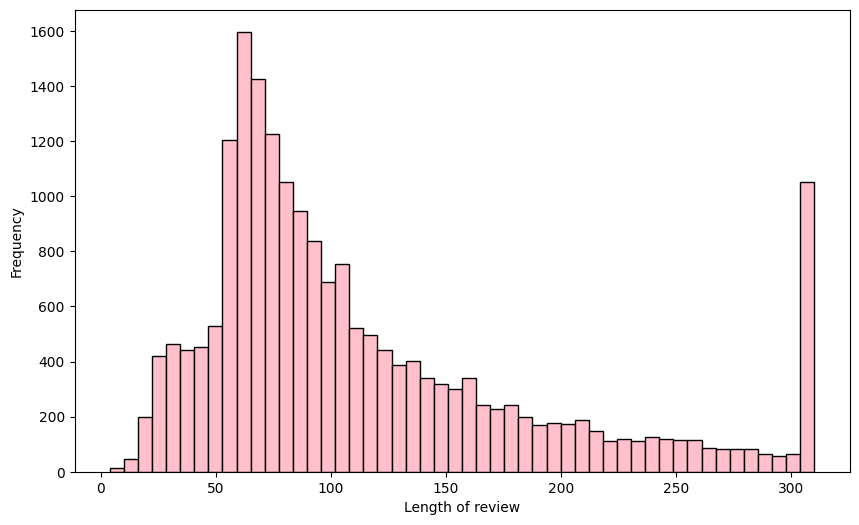

In [ ]:
review_lengths = df_train["processed_text"].apply(len)


plt.figure(figsize=(10, 6))
plt.hist(review_lengths, bins=50, color='pink', edgecolor='black')
plt.xlabel("Length of review")
plt.ylabel("Frequency")
plt.show()

## Реализация Dataset и DataLoader

Текстовые данные в обучающей, валидационной и тестовой выборках предобработаны, словари для перевода уникальных слов в целочисленные индексы и обратно подготовлены. Теперь можно написать класс `Dataset` и подготовить `DataLoader`-ы для будущей подачи данных в PyTorch модель.

Сейчас данные всех трех подвыборок хранятся в датафреймах подобного формата:

In [ ]:
df_val.head()

,text,label,processed_text
0,"That 70s Show is the best TV show ever, period...",1,"[show, best, tv, show, ever, period, andy, gri..."
1,"This is a must see for independant movie fans,...",1,"[must, see, independant, movie, fan, also, hol..."
2,"After watching this, I had lost a little respe...",0,"[watch, lose, little, respect, christopher, le..."
3,...through the similarly minded antics of Eric...,0,"[similarly, mind, antic, eric, stanze, notpart..."
4,Everything I remember about it was excellent.....,1,"[everything, remember, excellent, great, cast,..."


Допишите класс `IMDBDataset`. При инициализации он принимает в себя датафрейм `dataframe` и словарь перевода слова в целочисленный индекс `word_to_id`.

Реализуйте методы `__getitem__` и `__len__`.

Метод `__getitem__` должен по индексу `idx` возвращать кортеж `(word_ids, y)`, где:
* `word_ids` — тензор класса `torch.LongTensor`, содержащий индексы слов в отзыве номер `idx` согласно словарю `word_to_id`. Если слова нет в словаре, используется индекс токена `<UNK>`.
* `y` — одно целое число, метка класса отзыва номер `idx`.

Метод `__len__` должен возвращать количество элементов в  датасете.

In [ ]:
from torch.utils.data import Dataset

class IMDBDataset(Dataset):
    def __init__(self, dataframe, word_to_id):
        self.data = dataframe['processed_text'].values
        self.target = dataframe['label'].values
        self.word_to_id = word_to_id
        self.unk_id = word_to_id["<UNK>"]
        self.pad_id = word_to_id["<PAD>"]

    def __len__(self):
      return len(self.data)


    def __getitem__(self, idx):
        text = self.data[idx]
        label = self.target[idx]

        word_ids = [self.word_to_id.get(word, self.unk_id) for word in text]

        word_ids_tensor = torch.Tensor(word_ids)

        word_ids_tensor = torch.tensor(word_ids_tensor, dtype=torch.int64)
        return word_ids_tensor, label

Создадим датасеты:

In [ ]:
train_dataset = IMDBDataset(df_train, word_to_id)
val_dataset = IMDBDataset(df_val, word_to_id)
test_dataset = IMDBDataset(df_test, word_to_id)

Проверим работу класса и выведем одну пару "вход-выход":

In [ ]:
word_ids, y = train_dataset[0]

assert (
    type(word_ids) == torch.Tensor and word_ids.dtype == torch.int64
), "Oops, something wrong!"
assert type(y) == np.int64 and y.shape == (), "Oops, something wrong!"
print("Everything is okay")
display(word_ids, y)

Everything is okay


<ipython-input-33-6728adbb045e>:23: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  word_ids_tensor = torch.tensor(word_ids_tensor, dtype=torch.int64)


tensor([   0,    1,    2,    3,    4,    5,    6,    7,    8,    9,   10,   11,
          12,   13,   14,   15,   16,   17,   18,   19,   20,   21,   22,   23,
          24,    3,   25,   26,    3,   27,   28,    3,   26, 5108,   12,   13,
          29,   30, 5108,   31,   32,   33,   24,   34,   23,   35,   36,   34,
          23,   37,   38,   39, 5108,   40,   41,   25,   26,   42,   43, 5108,
          44,    5,   45,   46,   47,   48,   49,   50,   51,   52,   22,   23,
          53, 5108,   54,   55,   56, 5108,   57,   58,   31,   59,   60,   61,
          62,   63,   64,   65, 5108,   56,   22,   23,   66,    2,    3,   67,
          68,   69,   70,    3,   71,   51,   59,    1,   72, 5108, 5108,   73,
          74,   44,    5,   75,   76,   77, 5108, 5108,   78,   79,   80,   81,
          82,   83,   51,   84,   85,   86,   87,   73,   41,   85,    5, 5108,
          55,   34, 5108,   45,   88,   76,   89, 5108, 5108,   90,   91, 5108,
        5108,   92,   93,   94, 5108,   

np.int64(1)

Несмотря на то, что RNN способны обрабатывать последовательности произвольной длины, технически во время обучения по батчам необходимо, чтобы все отзывы в батче имели единую длину. Для этого их дополняют индексами токена `<PAD>`.

Обратите внимание! Мы могли сделать дополнение отзывов до единой длины `max_length` токенами `<PAD>` на этапе работы с датафреймами, но это неэффективно по двум причинам:

1.   Будет бесполезно заниматься лишняя память на хранение дополненных до единой длины отзывов.
2.   При семплировании батчей может оказаться, что все отзывы в рамках батча имеют длину меньше, чем `max_length`. Тогда, чтобы выполнить техническое условие о равенстве длин, достаточно дополнять отзывы до длины максимального отзыва в рамках батча.

Для приведения последовательностей к единой длине в рамках батча существует функция `torch.nn.utils.rnn.pad_sequence` [🛠️[doc]](https://pytorch.org/docs/stable/generated/torch.nn.utils.rnn.pad_sequence.html). Для ее применения внутри процесса формирования батчей требуется переопределить стандартную функцию `collate_fn` в `DataLoader` и вызвать `pad_sequence` внутри `collate_fn`.

In [ ]:
from torch.nn.utils.rnn import pad_sequence


def collate_fn(batch):
    word_ids, y = list(zip(*batch))
    padded_ids = pad_sequence(
        word_ids, batch_first=True, padding_value=float(word_to_id["<PAD>"])
    )
    y = torch.Tensor(y)
    return padded_ids, y

Создадим `DataLoader`-ы для обучающих, валидационных и тестовых данных. Обратите внимание на то, что мы передаем в `DataLoader`-ы самостоятельно определенную `collate_fn`.

In [ ]:
from torch.utils.data import DataLoader

batch_size = 512

train_loader = DataLoader(
    train_dataset, collate_fn=collate_fn, batch_size=batch_size, shuffle=True
)

val_loader = DataLoader(
    val_dataset, collate_fn=collate_fn, batch_size=batch_size, shuffle=False
)

test_loader = DataLoader(
    test_dataset, collate_fn=collate_fn, batch_size=batch_size, shuffle=False
)

Проверим формирование батчей:

In [ ]:
x, y = next(iter(train_loader))
x.shape, y.shape

<ipython-input-33-6728adbb045e>:23: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  word_ids_tensor = torch.tensor(word_ids_tensor, dtype=torch.int64)


(torch.Size([512, 310]), torch.Size([512]))

## Создание модели

Опишите модель рекуррентной нейронной сети на базе GRU для классификации отзывов. Используйте слои:

* [[doc] 🛠️](https://pytorch.org/docs/stable/generated/torch.nn.Embedding.html) `nn.Embedding` для перевода индексов слов в обучаемые вектора-эмбеддинги
* [[doc] 🛠️](https://pytorch.org/docs/stable/generated/torch.nn.RNN.html#torch.nn.GRU) `nn.GRU` для рекуррентной обработки последовательности эмбеддингов слов и формирования последовательности скрытых состояний
* [[doc] 🛠️](https://pytorch.org/docs/stable/generated/torch.nn.Linear.html) `nn.Linear` для предсказания метки класса по последнему скрытому состоянию (формат "many-to-one")

In [ ]:
import torch.nn as nn

class GRUClassifier(nn.Module):
    def __init__(self, vocab_size, embedding_dim, hidden_dim, output_dim):
        super().__init__()
        self.embedding = nn.Embedding(vocab_size, embedding_dim, padding_idx=word_to_id["<PAD>"])
        self.gru = nn.GRU(embedding_dim, hidden_dim, batch_first=True)
        self.fc1 =  nn.Linear(hidden_dim, hidden_dim//2)
        self.bn = nn.BatchNorm1d(hidden_dim//2)
        self.activation=nn.ReLU()
        self.fc2 = nn.Linear(hidden_dim//2, output_dim)


    def forward(self, x):
        x = self.embedding(x)
        _, h_n = self.gru(x)
        out = self.fc1(h_n[-1])
        out = self.activation(self.bn(out))
        out = self.fc2(out)
        return out.squeeze()

Инициализируем модель, возьмем один батч данных и пропустим входные данные через модель, чтобы убедиться, что нигде ничего не ломается и все размерности подходят.

In [ ]:
# model hyperparameters
vocab_size = len(vocab)
embedding_dim = 128
hidden_dim = 512
output_dim = 1  # because of binary classification

# model initializing
model = GRUClassifier(
    vocab_size=vocab_size,
    embedding_dim=embedding_dim,
    hidden_dim=hidden_dim,
    output_dim=output_dim,
)
print(model)

x, y = next(iter(train_loader))
out = model(x)

assert out.shape == y.shape, "Oops, something wrong!"
print(f"Model output shape: {out.shape}")
print(f"Target shape:       {y.shape}")

GRUClassifier(
  (embedding): Embedding(5109, 128, padding_idx=5107)
  (gru): GRU(128, 512, batch_first=True)
  (fc1): Linear(in_features=512, out_features=256, bias=True)
  (bn): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (activation): ReLU()
  (fc2): Linear(in_features=256, out_features=1, bias=True)
)


<ipython-input-33-6728adbb045e>:23: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  word_ids_tensor = torch.tensor(word_ids_tensor, dtype=torch.int64)


Model output shape: torch.Size([512])
Target shape:       torch.Size([512])


## Обучение нейронной сети

Для обучения, валидации и тестирования нейронной сети используется стандартный Lightning-пайплайн:

* в качестве функции потерь используется `nn.BCEWithLogitsLoss` [🛠️[doc]](https://pytorch.org/docs/stable/generated/torch.nn.BCEWithLogitsLoss.html#torch.nn.BCEWithLogitsLoss). Обратите внимание, чтобы у модели не было сигмоиды на выходе, так как она уже предусмотрена в этой функции потерь.
* в качестве метрик качества используются `BinaryAccuracy` и `BinaryAUROC`.
* в качестве оптимизатора — `torch.optim.Adam` [🛠️[doc]](https://pytorch.org/docs/stable/generated/torch.optim.Adam.html#torch.optim.Adam) со стандартными гиперпараметрами.

Также в данном пайплайне реализован метод `predict`, который принимает список "сырых" отзывов, производит полную их предобработку и возвращает предсказания эмоциональной окрашенности.

In [ ]:
import lightning as L
from torch import nn
from torchmetrics import MetricCollection
from torchmetrics.classification import BinaryAccuracy, BinaryAUROC
from typing import List


class ClassificationPipeline(L.LightningModule):
    def __init__(self, model, criterion=nn.BCEWithLogitsLoss()):
        super().__init__()
        self.model = model
        self.criterion = criterion
        metrics = MetricCollection([BinaryAccuracy(), BinaryAUROC()])
        self.train_metrics = metrics.clone(postfix="/train")
        self.val_metrics = metrics.clone(postfix="/val")
        self.test_metrics = metrics.clone(postfix="/test")

    def configure_optimizers(self):
        optimizer = torch.optim.Adam(self.model.parameters())
        return optimizer

    def training_step(self, batch, batch_idx):
        x, y = batch
        out = self.model(x)
        loss = self.criterion(out, y)
        self.log("Loss/train", loss, on_step=False, on_epoch=True)
        self.train_metrics.update(out, y)
        return loss

    def validation_step(self, batch, batch_idx):
        x, y = batch
        out = self.model(x)
        loss = self.criterion(out, y)
        self.log("Loss/val", loss, on_step=False, on_epoch=True)
        self.val_metrics.update(out, y)

    def test_step(self, batch, batch_idx):
        x, y = batch
        out = self.model(x)
        self.test_metrics.update(out, y)

    def on_training_epoch_end(self):
        train_metrics = self.train_metrics.compute()
        self.log_dict(train_metrics)
        self.train_metrics.reset()

    def on_validation_epoch_end(self):
        val_metrics = self.val_metrics.compute()
        self.log_dict(val_metrics)
        self.val_metrics.reset()

    def on_test_epoch_end(self):
        test_metrics = self.test_metrics.compute()
        self.log_dict(test_metrics)
        self.test_metrics.reset()

    def predict(self, texts: List):
        def preprocessing(text):
            text = text.lower()
            text = remove_punktuation(text)
            text = word_tokenize(text)
            text = remove_stop_words(text)
            text = lemmatize(text)
            text = truncate(text, max_length)
            return text

        df = pd.DataFrame({"text": texts, "label": [np.nan] * len(texts)})
        df["processed_text"] = df["text"].apply(preprocessing)
        dataset = IMDBDataset(df, word_to_id)
        dataloader = DataLoader(
            dataset, collate_fn=collate_fn, batch_size=len(dataset), shuffle=False
        )
        x, y = next(iter(dataloader))
        out = self.model(x).detach()
        out = torch.sigmoid(out).numpy()

        result = [
            [
                {"label": "POSITIVE", "score": score},
                {"label": "NEGATIVE", "score": (1 - score)},
            ]
            for score in out
        ]

        return result

Подготовим все к обучению и запустим его.

Будем применять `ModelCheckpoint` callback с сохранением чекпоинтов модели по максимальному значению accuracy на валидации, а также логировать процесс в TensorBoard.

In [ ]:
from lightning.pytorch import Trainer
from lightning.pytorch.callbacks import ModelCheckpoint
from lightning.pytorch.loggers import TensorBoardLogger


checkpoint_callback = ModelCheckpoint(
    monitor="BinaryAccuracy/val", mode="max", filename="best"
)

exp_name = "sentiment_classification_gru"
trainer = Trainer(
    max_epochs=15,
    logger=TensorBoardLogger(save_dir=f"lightning_logs", name=exp_name),
    num_sanity_val_steps=1,
    callbacks=[checkpoint_callback],
    log_every_n_steps=1,
)

set_random_seed(42)

model = GRUClassifier(
    vocab_size=vocab_size,
    embedding_dim=embedding_dim,
    hidden_dim=hidden_dim,
    output_dim=output_dim,
)

pipeline = ClassificationPipeline(model=model)

trainer.fit(model=pipeline, train_dataloaders=train_loader, val_dataloaders=val_loader)

INFO: GPU available: True (cuda), used: True
INFO:lightning.pytorch.utilities.rank_zero:GPU available: True (cuda), used: True
INFO: TPU available: False, using: 0 TPU cores
INFO:lightning.pytorch.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO: HPU available: False, using: 0 HPUs
INFO:lightning.pytorch.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO: Seed set to 42
INFO:lightning.fabric.utilities.seed:Seed set to 42
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO: 
  | Name          | Type              | Params | Mode 
------------------------------------------------------------
0 | model         | GRUClassifier     | 1.8 M  | train
1 | criterion     | BCEWithLogitsLoss | 0      | train
2 | train_metrics | MetricCollection  | 0      | train
3 | val_metrics   | MetricCollection  | 0      | train
4 | test_metrics  | MetricCollection  | 0      | train
-------------------

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

<ipython-input-33-6728adbb045e>:23: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  word_ids_tensor = torch.tensor(word_ids_tensor, dtype=torch.int64)


Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO: `Trainer.fit` stopped: `max_epochs=15` reached.
INFO:lightning.pytorch.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=15` reached.


Выведем логи обучения с помощью tbparse:

In [ ]:
import matplotlib.pyplot as plt
from tbparse import SummaryReader
from collections import defaultdict


def tbparse_visual(log_path):
    def collect_groups(df):
        tags = df.tag.unique().tolist()
        groups = defaultdict(list)
        for tag in tags:
            if "/" in tag:
                group = tag[: tag.find("/")]

                if group not in groups:
                    groups[group] = [tag]
                else:
                    groups[group].append(tag)
        return groups

    reader = SummaryReader(log_path)
    df = reader.scalars
    groups = collect_groups(df)
    for group in groups:
        plt.figure(figsize=(12, 4))
        for tag in groups[group]:
            tag_data = df.query("tag == @tag").sort_values(by="step")
            plt.plot(tag_data.step, tag_data.value, label=tag)
        plt.xlabel("step")
        plt.ylabel(f"{group}")
        plt.legend()
        plt.grid()
        plt.show()

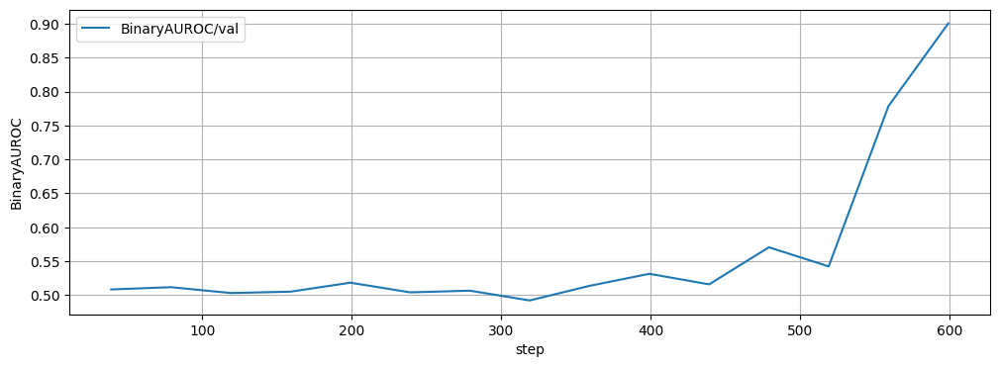

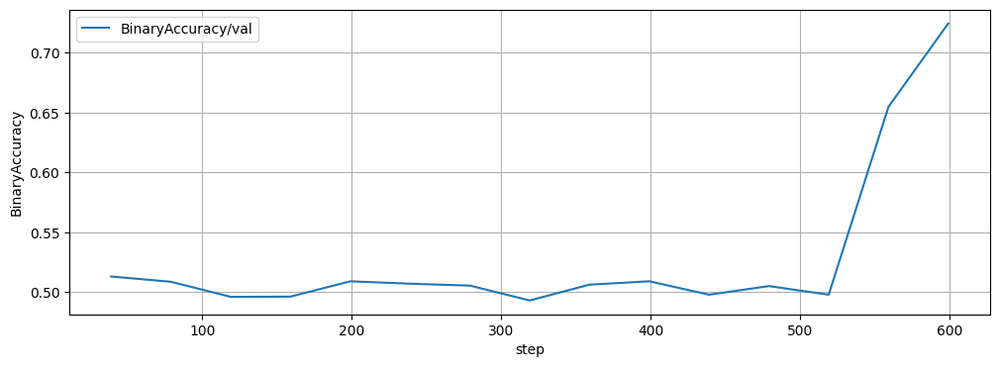

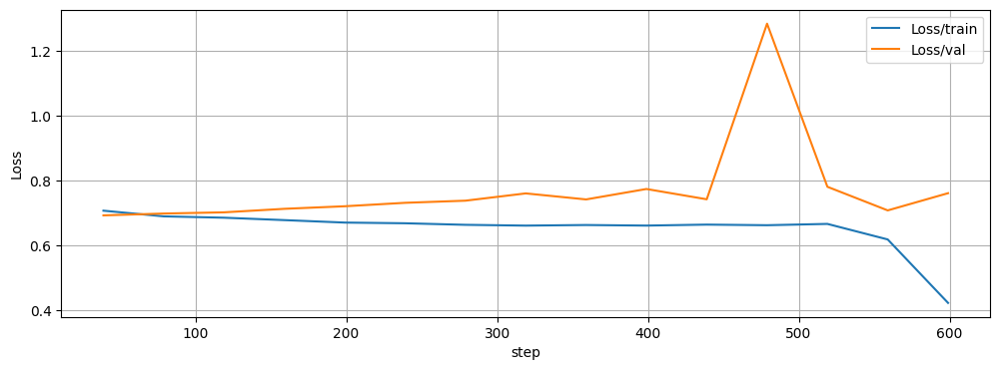

In [ ]:
import os

base_path = f"/content/lightning_logs/{exp_name}"
last_version = sorted(os.listdir(base_path))[-1]
log_path = f"{base_path}/{last_version}"

tbparse_visual(log_path)

## Тестирование нейронной сети и оценка качества работы

Выполним оценку качества модели на тестовых данных:

In [ ]:
trainer.test(model=pipeline, dataloaders=test_loader, ckpt_path="best");

INFO: Restoring states from the checkpoint path at lightning_logs/sentiment_classification_gru/version_1/checkpoints/best.ckpt
INFO:lightning.pytorch.utilities.rank_zero:Restoring states from the checkpoint path at lightning_logs/sentiment_classification_gru/version_1/checkpoints/best.ckpt
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO: Loaded model weights from the checkpoint at lightning_logs/sentiment_classification_gru/version_1/checkpoints/best.ckpt
INFO:lightning.pytorch.utilities.rank_zero:Loaded model weights from the checkpoint at lightning_logs/sentiment_classification_gru/version_1/checkpoints/best.ckpt


Testing: |          | 0/? [00:00<?, ?it/s]

<ipython-input-33-6728adbb045e>:23: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  word_ids_tensor = torch.tensor(word_ids_tensor, dtype=torch.int64)


┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│     BinaryAUROC/test      │    0.8968051671981812     │
│    BinaryAccuracy/test    │     0.72843998670578      │
└───────────────────────────┴───────────────────────────┘

Посмотрим на предсказания модели для нескольких отзывов из тестовой выборки:

In [ ]:
test = df_test.sample(5)
test

,text,label,processed_text
6868,I could not believe how terrible and boring th...,0,"[could, believe, terrible, boring, hollywood, ..."
24016,I rented Boogie Nights last week and I could t...,1,"[rent, boogie, night, last, week, could, tell,..."
9668,"First off, this movie is not near complete, my...",0,"[first, movie, near, complete, guess, someone,..."
13640,I watched this mini in the early eighties. Sam...,1,"[watch, mini, early, eighty, sam, waterson, pr..."
14018,This movie was never intended as a big-budget ...,1,"[movie, never, intend, bigbudget, film, cute, ..."


In [ ]:
pipeline.predict(test["text"].tolist())

<ipython-input-33-6728adbb045e>:23: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  word_ids_tensor = torch.tensor(word_ids_tensor, dtype=torch.int64)


[[{'label': 'POSITIVE', 'score': np.float32(0.10018399)},
  {'label': 'NEGATIVE', 'score': np.float32(0.89981604)}],
 [{'label': 'POSITIVE', 'score': np.float32(0.98214555)},
  {'label': 'NEGATIVE', 'score': np.float32(0.017854452)}],
 [{'label': 'POSITIVE', 'score': np.float32(0.06942602)},
  {'label': 'NEGATIVE', 'score': np.float32(0.930574)}],
 [{'label': 'POSITIVE', 'score': np.float32(0.96023375)},
  {'label': 'NEGATIVE', 'score': np.float32(0.039766252)}],
 [{'label': 'POSITIVE', 'score': np.float32(0.032414652)},
  {'label': 'NEGATIVE', 'score': np.float32(0.9675853)}]]

Сделайте выводы о качестве обработки тестовой выборки:

Accuracy на тесте составила 0.73, модель уже работает лучше, чем случайное предсказание классов. Но может классифицировать негативные отзывы, как позитивные.

## Исследование влияния двунаправленности на качество решения задачи

Опишите модель рекуррентной нейронной сети на базе GRU, состоящей из тех же слоев, что и прежде, но при этом предусмотрите возможность выполнения в рекуррентном GRU модуле **двунаправленной обработки последовательностей** (параметр `bidirectional`).

Обратите внимание, что от значения параметра `bidirectional` зависит размерность тензора `h`, который передается в линейный слой для классификации (при `bidirectional=True` линейный слой получает вдвое больше признаков). Это нужно учитывать при инициализации линейного слоя.

In [ ]:
import torch.nn as nn

class GRUBidirectionalClassifier(nn.Module):
    def __init__(self, vocab_size, embedding_dim, hidden_dim, output_dim, bidirectional):
        super().__init__()
        self.embedding = nn.Embedding(vocab_size, embedding_dim, padding_idx=word_to_id["<PAD>"])
        self.gru = nn.GRU(embedding_dim, hidden_dim, batch_first=True,bidirectional=bidirectional)
        self.fc1 =  nn.Linear(hidden_dim, hidden_dim//2)
        self.bn = nn.BatchNorm1d(hidden_dim//2)
        self.activation=nn.ReLU()
        self.fc2 = nn.Linear(hidden_dim//2, output_dim)

    def forward(self, x):
        x = self.embedding(x)
        _, h_n = self.gru(x)
        out = self.fc1(h_n[-1])
        out = self.activation(self.bn(out))
        out = self.fc2(out)
        return out.squeeze()

Инициализируем модель, возьмем один батч данных и пропустим входные данные через модель, чтобы убедиться, что нигде ничего не ломается и все размерности подходят.

При `bidirectional = False`:

In [ ]:
bidirectional = False

# model initializing
model = GRUBidirectionalClassifier(
    vocab_size=vocab_size,
    embedding_dim=embedding_dim,
    hidden_dim=hidden_dim,
    output_dim=output_dim,
    bidirectional=bidirectional,
)
print(model)

x, y = next(iter(train_loader))
out = model(x)

assert out.shape == y.shape, "Oops, something wrong!"
print(f"Model output shape: {out.shape}")
print(f"Target shape:       {y.shape}")

GRUBidirectionalClassifier(
  (embedding): Embedding(5109, 128, padding_idx=5107)
  (gru): GRU(128, 512, batch_first=True)
  (fc1): Linear(in_features=512, out_features=256, bias=True)
  (bn): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (activation): ReLU()
  (fc2): Linear(in_features=256, out_features=1, bias=True)
)


<ipython-input-33-6728adbb045e>:23: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  word_ids_tensor = torch.tensor(word_ids_tensor, dtype=torch.int64)


Model output shape: torch.Size([512])
Target shape:       torch.Size([512])


При `bidirectional = True`:

In [ ]:
bidirectional = True

# model initializing
model = GRUBidirectionalClassifier(
    vocab_size=vocab_size,
    embedding_dim=embedding_dim,
    hidden_dim=hidden_dim,
    output_dim=output_dim,
    bidirectional=bidirectional,
)
print(model)

x, y = next(iter(train_loader))
out = model(x)

assert out.shape == y.shape, "Oops, something wrong!"
print(f"Model output shape: {out.shape}")
print(f"Target shape:       {y.shape}")

GRUBidirectionalClassifier(
  (embedding): Embedding(5109, 128, padding_idx=5107)
  (gru): GRU(128, 512, batch_first=True, bidirectional=True)
  (fc1): Linear(in_features=512, out_features=256, bias=True)
  (bn): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (activation): ReLU()
  (fc2): Linear(in_features=256, out_features=1, bias=True)
)


<ipython-input-33-6728adbb045e>:23: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  word_ids_tensor = torch.tensor(word_ids_tensor, dtype=torch.int64)


Model output shape: torch.Size([512])
Target shape:       torch.Size([512])


Запустим обучение модели:

In [ ]:
checkpoint_callback = ModelCheckpoint(
    monitor="BinaryAccuracy/val", mode="max", filename="best"
)

exp_name = "sentiment_classification_bidirectional_gru"
trainer = Trainer(
    max_epochs=15,
    logger=TensorBoardLogger(save_dir=f"lightning_logs", name=exp_name),
    num_sanity_val_steps=1,
    callbacks=[checkpoint_callback],
    log_every_n_steps=1,
)

set_random_seed(42)

model = GRUBidirectionalClassifier(
    vocab_size=vocab_size,
    embedding_dim=embedding_dim,
    hidden_dim=hidden_dim,
    output_dim=output_dim,
    bidirectional=bidirectional,
)

pipeline = ClassificationPipeline(model=model)

trainer.fit(model=pipeline, train_dataloaders=train_loader, val_dataloaders=val_loader)

INFO: GPU available: True (cuda), used: True
INFO:lightning.pytorch.utilities.rank_zero:GPU available: True (cuda), used: True
INFO: TPU available: False, using: 0 TPU cores
INFO:lightning.pytorch.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO: HPU available: False, using: 0 HPUs
INFO:lightning.pytorch.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO: Seed set to 42
INFO:lightning.fabric.utilities.seed:Seed set to 42
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO: 
  | Name          | Type                       | Params | Mode 
---------------------------------------------------------------------
0 | model         | GRUBidirectionalClassifier | 2.8 M  | train
1 | criterion     | BCEWithLogitsLoss          | 0      | train
2 | train_metrics | MetricCollection           | 0      | train
3 | val_metrics   | MetricCollection           | 0      | train
4 | test_metrics  | 

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

<ipython-input-33-6728adbb045e>:23: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  word_ids_tensor = torch.tensor(word_ids_tensor, dtype=torch.int64)


Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO: `Trainer.fit` stopped: `max_epochs=15` reached.
INFO:lightning.pytorch.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=15` reached.


Выведем логи обучения с помощью tbparse:

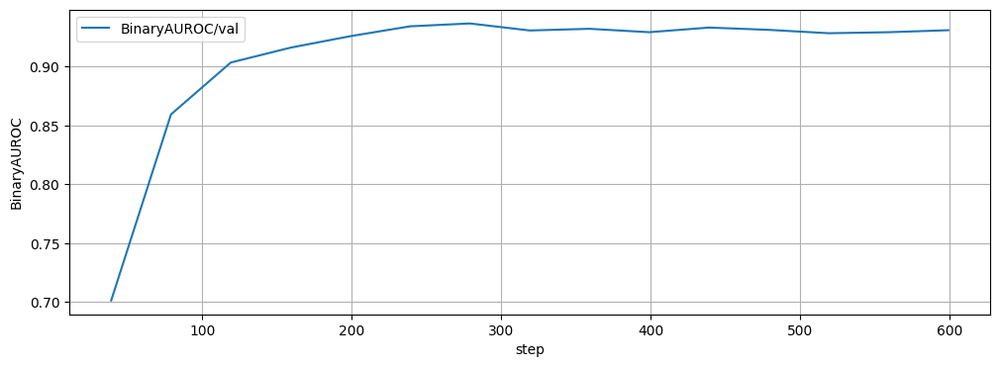

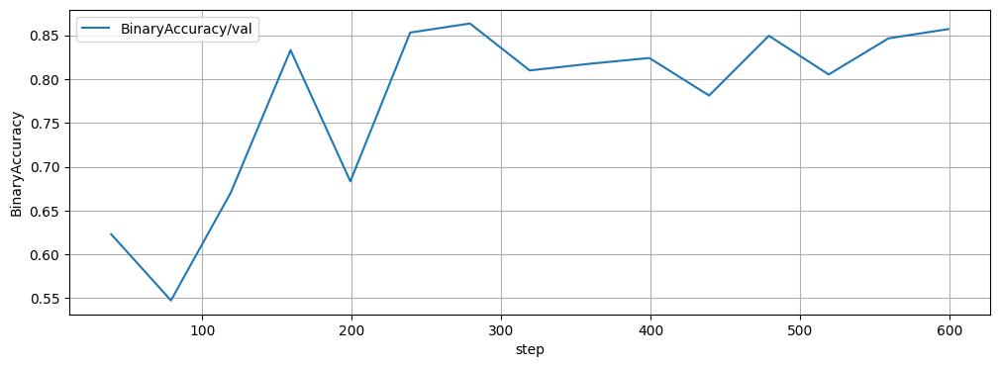

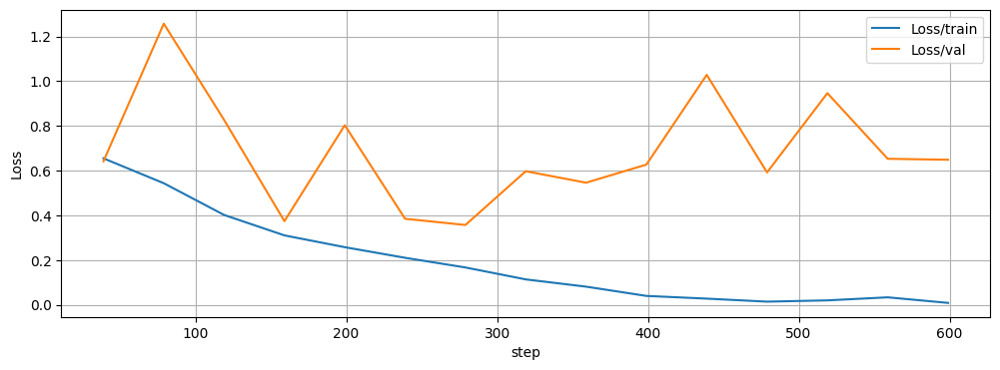

In [ ]:
base_path = f"/content/lightning_logs/{exp_name}"
last_version = sorted(os.listdir(base_path))[-1]
log_path = f"{base_path}/{last_version}"

tbparse_visual(log_path)

Выполним оценку качества модели на тестовых данных:

In [ ]:
trainer.test(model=pipeline, dataloaders=test_loader, ckpt_path="best");

INFO: Restoring states from the checkpoint path at lightning_logs/sentiment_classification_bidirectional_gru/version_0/checkpoints/best.ckpt
INFO:lightning.pytorch.utilities.rank_zero:Restoring states from the checkpoint path at lightning_logs/sentiment_classification_bidirectional_gru/version_0/checkpoints/best.ckpt
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO: Loaded model weights from the checkpoint at lightning_logs/sentiment_classification_bidirectional_gru/version_0/checkpoints/best.ckpt
INFO:lightning.pytorch.utilities.rank_zero:Loaded model weights from the checkpoint at lightning_logs/sentiment_classification_bidirectional_gru/version_0/checkpoints/best.ckpt


Testing: |          | 0/? [00:00<?, ?it/s]

<ipython-input-33-6728adbb045e>:23: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  word_ids_tensor = torch.tensor(word_ids_tensor, dtype=torch.int64)


┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│     BinaryAUROC/test      │    0.9281333088874817     │
│    BinaryAccuracy/test    │    0.8497200012207031     │
└───────────────────────────┴───────────────────────────┘

In [ ]:
test = df_test.sample(5)
for i in test['text'].index:
  print(test.loc[i, 'text'])

First of all, no one with any law enforcement experience (Not ER or EMT, but real law enforcement) takes this show seriously. Walker would be drummed out of any police force in the US for his illegal and totally unprofessional tactics. On top of that, he is a comic book character---no acting ability, incredibly trite lines, no character development. The fact that Alex Cahill loves him shows just how dumb blondes really are. And Trivett is the ultimate clown in black-face. Come on---if you think Walker is a heartfelt show without bias, then explain why JT is treated as a dolt, always is the subject of Walker's jokes, never is allowed to be the one to solve the crime, and never rescues Walker, who should be dead 50 times over for the stupid things he does. While it may be true that many criminals are even dumber than the detectives who go after them (and believe me, most cops are dumber than dirt), the smart ones Walker comes up against never seem to get the point that once Walker is cap

In [ ]:
pipeline.predict(test["text"].tolist())

<ipython-input-33-6728adbb045e>:23: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  word_ids_tensor = torch.tensor(word_ids_tensor, dtype=torch.int64)


[[{'label': 'POSITIVE', 'score': np.float32(0.0006371642)},
  {'label': 'NEGATIVE', 'score': np.float32(0.9993628)}],
 [{'label': 'POSITIVE', 'score': np.float32(0.20485014)},
  {'label': 'NEGATIVE', 'score': np.float32(0.79514986)}],
 [{'label': 'POSITIVE', 'score': np.float32(0.6657425)},
  {'label': 'NEGATIVE', 'score': np.float32(0.33425748)}],
 [{'label': 'POSITIVE', 'score': np.float32(0.99844474)},
  {'label': 'NEGATIVE', 'score': np.float32(0.001555264)}],
 [{'label': 'POSITIVE', 'score': np.float32(0.75793856)},
  {'label': 'NEGATIVE', 'score': np.float32(0.24206144)}]]

Возьмите несколько отзывов на фильмы с [сайта IMDB](https://www.imdb.com/) (как позитивных, так и негативных) и выведите предсказания модели для них.

In [ ]:
positive_reviews = [
    'Every episode has a different story to tell which is why I love it because I can pause and continue whenever I feel like. And every episode addresses different social issues from day to day life in a carefully thought symbolic maze. You can easily understand some episodes while with other episodes one needs some pondering over. With me it was mostly that plus the shock and hundreds of questions popping up!! Some episodes have managed to creep me out for days together. :D',
    "Absolutely on of the best series i've ever watched. One word: BRILLIANT! Looking forward to seeing more episodes of Black Mirror!",
    "A mix between sci-fi, thriller, drama and sarcastic comedy depicting a possible future and sometimes the very present moment of our society. The evolution and possibles scenarios of the merging between humans and technology. I love this series"
]
negative_reviews = [
    "I watch the first episode and immediately turned it off and deleted my Netflix account. No way they're getting my money if they put it towards creating shows like this. And I hear they have new episodes coming out all the time? What has become of this world we live in? Utter garbage.",
    "S5 : what happened ? Complete garbage !! Bring back the true Black Mirror !",
    "Worst script I have ever encountered. In the same league as the lowest budget teen TV series from Disney Channel. I am almost a little bit impressed by how bad it was and how painful it was to watch."
]

In [ ]:
pipeline.predict(positive_reviews)


<ipython-input-33-6728adbb045e>:23: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  word_ids_tensor = torch.tensor(word_ids_tensor, dtype=torch.int64)


[[{'label': 'POSITIVE', 'score': np.float32(0.9999813)},
  {'label': 'NEGATIVE', 'score': np.float32(1.8715858e-05)}],
 [{'label': 'POSITIVE', 'score': np.float32(0.9999881)},
  {'label': 'NEGATIVE', 'score': np.float32(1.1920929e-05)}],
 [{'label': 'POSITIVE', 'score': np.float32(0.99999917)},
  {'label': 'NEGATIVE', 'score': np.float32(8.34465e-07)}]]

In [ ]:
pipeline.predict(negative_reviews)

<ipython-input-33-6728adbb045e>:23: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  word_ids_tensor = torch.tensor(word_ids_tensor, dtype=torch.int64)


[[{'label': 'POSITIVE', 'score': np.float32(0.9998018)},
  {'label': 'NEGATIVE', 'score': np.float32(0.00019818544)}],
 [{'label': 'POSITIVE', 'score': np.float32(0.99940956)},
  {'label': 'NEGATIVE', 'score': np.float32(0.0005904436)}],
 [{'label': 'POSITIVE', 'score': np.float32(0.8015193)},
  {'label': 'NEGATIVE', 'score': np.float32(0.19848073)}]]

Сделайте выводы о качестве обработки тестовой выборки при двунаправленной обработке текста:

Использование двунаправленности дало прирост в качесте. Теперь accuracy составляет 0.85. Но есть проблема, которая видна как на семлпе из тестовых данных, так и на отзывах с сайта. Негативным отзывы модель ложно оценивает, как позитивные.

## Заключение

Мы на практике познакомились с решением задачи классификации текстовых данных с помощью рекуррентных нейронных сетей типа GRU, прошли через необходимые этапы предобработки текстовых данных, реализовали их на базе библиотеки NLTK.

Также мы познакомились с тем, как создавать рекуррентные нейронные сети с двунаправленной обработкой последовательностей. Применение рекуррентных слоев с двунаправленностью обычно помогает более качественно обрабатывать длинные последовательности.

# Задание 3. Генерация фамилий

Возьмите следующий набор данных и, используя код из лекции, создайте рекуррентную сеть для генерации фамилий. Подумайте, как получить разные фамилии, начинающиеся на одну и ту же букву.

Импорт необходимых библиотек:

In [ ]:
import torch
import numpy as np
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
from pprint import pprint

Загрузка данных:

In [ ]:
!wget -q https://edunet.kea.su/repo/EduNet-web_dependencies/datasets/surnames.txt

In [ ]:
with open("surnames.txt", encoding="utf-8") as s_file:
    surnames_list = [line.strip().lower() for line in s_file.readlines()]

In [ ]:
print(f"Total number of surnames: {len(surnames_list)}")
print("First 10 samples:")
pprint(surnames_list[:10])

Total number of surnames: 46240
First 10 samples:
['иванов',
 'кузнецов',
 'попов',
 'смирнов',
 'иванова',
 'васильев',
 'петров',
 'кузнецова',
 'волков',
 'соколов']


In [ ]:
from torch.nn.utils.rnn import pad_sequence
all_characters = "абвгдеёжзийклмнопрстуфхцчшщъыьэюя\n"
char_to_index = {char: i for i, char in enumerate(all_characters, start=0)}

def surnames_to_idx(surnames_list):
  idx_surnames = []
  for surname in surnames_list:
    surname += '\n'
    idx_surname = [char_to_index[char] for char in surname]
    idx_surnames.append(idx_surname)
  return idx_surnames

def prepare_data(surnames_list):
  data = []
  for surname in surnames_list:
    input_seq = torch.tensor(surname[:-1])
    target_seq = torch.tensor(surname[1:])
    data.append((input_seq,target_seq))
  return data

data = prepare_data(surnames_to_idx(surnames_list))
batch_size = 2048

def collate_fn(batch):
    input_seqs = [item[0] for item in batch]
    target_seqs = [item[1] for item in batch]
    padded_inputs = pad_sequence(input_seqs, batch_first=True, padding_value=char_to_index['\n'])
    padded_targets = pad_sequence(target_seqs, batch_first=True, padding_value=char_to_index['\n'])
    return padded_inputs, padded_targets


train_loader = torch.utils.data.DataLoader(
    data, batch_size=batch_size, shuffle=True,collate_fn=collate_fn
)

In [ ]:
class surname_gen(nn.Module):
    def __init__(self,hidden_size, output_size,dropout=0.3,embedding_dim = 10):
        super(surname_gen, self).__init__()
        self.hidden_size = hidden_size
        self.emb = nn.Embedding(num_embeddings=output_size, embedding_dim=embedding_dim)
        self.rnn = nn.RNN(embedding_dim, hidden_size, batch_first=True)
        self.dropout = nn.Dropout(dropout)
        self.fc = nn.Linear(hidden_size, output_size)

    def forward(self, x):
        x = self.emb(x)
        out, h = self.rnn(x)
        out = self.dropout(out)
        out = out.contiguous().view(-1, self.rnn.hidden_size)
        out = self.fc(out)
        return out


In [ ]:
class SurnameRNN(L.LightningModule):
    def __init__(self, model, lr= 0.002):
        super().__init__()
        self.model = model
        self.criterion = nn.CrossEntropyLoss()
        self.lr = lr

    def forward(self, inp):
        return self.model(inp)

    def training_step(self, batch, batch_idx):
        inp, tar = batch
        out = self.model(inp.long().to(self.device))
        loss = self.criterion(out, tar.view(-1).long().to(self.device))
        self.log('train_loss', loss, on_step=False, on_epoch=True, prog_bar=True)
        return loss

    def configure_optimizers(self):
        return torch.optim.Adam(self.parameters(), lr=self.lr)


In [ ]:
input_size = 1
hidden_size = 128
output_size = len(char_to_index)
num_epochs = 200
model = surname_gen(hidden_size, output_size)
pipeline = SurnameRNN(model)
trainer = L.Trainer(
    max_epochs=num_epochs,
    log_every_n_steps=50,
    gradient_clip_val=5.0,
    enable_progress_bar=False,
)

trainer.fit(pipeline, train_dataloaders=train_loader)

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO: 
  | Name      | Type             | Params | Mode 
-------------------------------------------------------
0 | model     | surname_gen      | 22.6 K | train
1 | criterion | CrossEntropyLoss | 0      | train
-------------------------------------------------------
22.6 K    Trainable params
0         Non-trainable params
22.6 K    Total params
0.091     Total estimated model params size (MB)
6         Modules in train mode
0         Modules in eval mode
INFO:lightning.pytorch.callbacks.model_summary:
  | Name      | Type             | Params | Mode 
-------------------------------------------------------
0 | mode

In [ ]:
index_to_char = {i: char for i, char in enumerate(all_characters)}
device = "cuda" if torch.cuda.is_available() else "cpu"
def predict_char(model,char,k=2):
  model.eval()
  out = model(torch.tensor([char_to_index[ch] for ch in char]).unsqueeze(0).to(device))

  prob = nn.functional.softmax(out[-1], dim=0).data

  top_k = torch.topk(prob.cpu(),k).indices.numpy()
  predicted_char = index_to_char[np.random.choice(top_k)]

  return predicted_char



def predict_surname(model,char,maxlen=10,k=2):
  predicted_char = predict_char(model,char)
  char += predicted_char
  name_len = 2
  while predicted_char != '\n' and name_len < maxlen:
    predicted_char = predict_char(model,char,k=k)
    char += predicted_char
    name_len+=1

  return char

model = pipeline.model
model.to(device)

for char in 'абвг':
  predicted_surname = predict_surname(model,char)
  predicted_surname = predicted_surname[:predicted_surname.find('\n')]
  print(f'{char} - {predicted_surname.capitalize()}')

а - Аланина
б - Барканова
в - Веленовая
г - Гольцован


In [ ]:
for char in 'гггг':
  predicted_surname = predict_surname(model,char)
  predicted_surname = predicted_surname[:predicted_surname.find('\n')]
  print(f'{char} - {predicted_surname.capitalize()}')

г - Горбанов
г - Гольцов
г - Горбако
г - Городнико


## Формат результата

Модель, генерирующая фамилии по первой букве.

Пример:

а — Аркова

б — Банова

в — Варенков

г — Гаранков

# Задание 4. Прогнозирование многомерного временного ряда

Попробуйте свои силы в анализе многомерных данных. Учтите, что признаки не независимы, разумно анализировать их одновременно.

В качестве датасета предлагаем [курс биткоина 🛠️[doc]](https://finance.yahoo.com/quote/BTC-USD/history?period1=1410912000&period2=1642118400&interval=1d&filter=history&frequency=1d&includeAdjustedClose=true).

## Формат результата

Графики предсказаний, RMSE для оценки качества предсказания.

Установка и импорт необходимых библиотек:

In [4]:
!pip install -q statsforecast
!pip install -q lightning==2.5.0

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.0/62.0 kB 6.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 354.6/354.6 kB 22.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 287.4/287.4 kB 30.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 280.5/280.5 kB 29.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 37.3/37.3 MB 27.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 41.0/41.0 kB 4.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 60.0/60.0 kB 6.0 MB/s eta 0:00:00


In [5]:
import os
import math
import torch
import random
import datetime
import numpy as np
import pandas as pd
import lightning as L
import torch.nn as nn
import matplotlib.pyplot as plt

from datetime import timedelta
from statsforecast import StatsForecast
from statsforecast.models import AutoARIMA
from lightning.pytorch import Trainer
from torchmetrics import MetricCollection
from sklearn.metrics import mean_squared_error
from sklearn.metrics import root_mean_squared_error
from torch.utils.data import Dataset, DataLoader
from sklearn.linear_model import LinearRegression
from torchmetrics.regression import MeanSquaredError
from lightning.pytorch.callbacks import ModelCheckpoint
from lightning.pytorch.loggers import TensorBoardLogger

Exception ignored on calling ctypes callback function: <function ThreadpoolController._find_libraries_with_dl_iterate_phdr.<locals>.match_library_callback at 0x7aeda93e7920>
Traceback (most recent call last):
  File "/usr/local/lib/python3.12/dist-packages/threadpoolctl.py", line 1005, in match_library_callback
    self._make_controller_from_path(filepath)
  File "/usr/local/lib/python3.12/dist-packages/threadpoolctl.py", line 1187, in _make_controller_from_path
    lib_controller = controller_class(
                     ^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.12/dist-packages/threadpoolctl.py", line 114, in __init__
    self.dynlib = ctypes.CDLL(filepath, mode=_RTLD_NOLOAD)
                  ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/lib/python3.12/ctypes/__init__.py", line 379, in __init__
    self._handle = _dlopen(self._name, mode)
                   ^^^^^^^^^^^^^^^^^^^^^^^^^
OSError: /usr/local/lib/python3.12/dist-packages/scipy.libs/libscipy_openblas-b75cc656.

##Загрузка и изучение данных

In [6]:
!wget -q https://edunet.kea.su/repo/EduNet-web_dependencies/datasets/BTC-USD.csv

In [8]:
dataset = pd.read_csv("BTC-USD.csv", index_col="Date", parse_dates=True)
dataset.head(3)

,Open,High,Low,Close,Volume
Date,,,,,
2017-11-29,10077.400391,11517.400391,9601.030273,9888.610352,11568799744
2017-11-30,9906.790039,10801.000000,9202.049805,10233.599609,8310689792
2017-12-01,10198.599609,11046.700195,9694.650391,10975.599609,6783119872


Это ежедневные исторические данные о ценах:

* `Open` — цена открытия,
* `High` — верхняя цена,
* `Low` — нижняя цена,
* `Volume` — объём торгов.

Наша цель — предсказать цену в будущем, но не просто на завтрашний день, а в будущее на несколько месяцев.

Визуализируем целевую переменную.

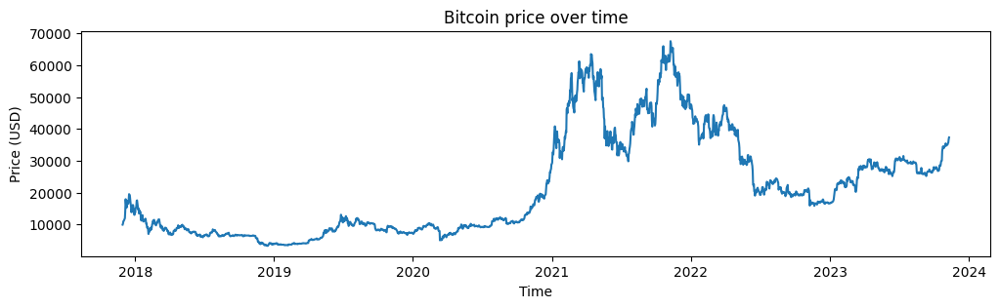

In [9]:
plt.rcParams["figure.figsize"] = (12, 3)

plt.plot(dataset["Close"])
plt.xlabel("Time")
plt.ylabel("Price (USD)")
plt.title("Bitcoin price over time")
plt.show()

Посмотрим, какие представлены дополнительные признаки.

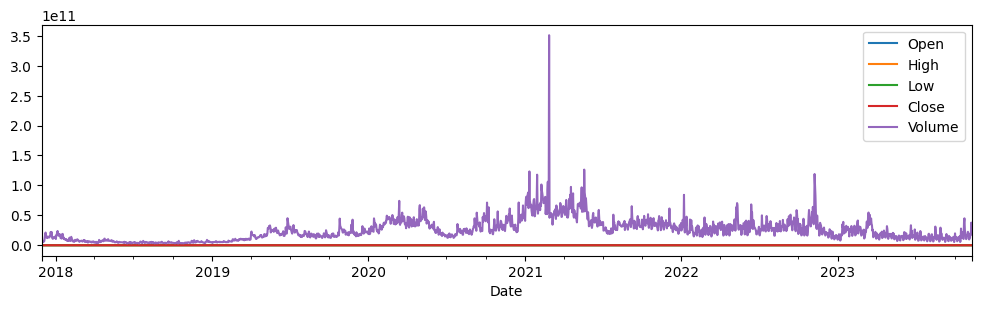

In [10]:
dataset.plot()
plt.show()

Видим единственное значение-всплеск в ряде `Volume`. Из-за такой разницы в масштабе даже толком не видно ничего. Заменим это значение на соседнее.

In [11]:
idx_max = dataset["Volume"].idxmax()

In [12]:
prev_value = dataset[dataset.index < idx_max].tail(1)["Volume"].iloc[0]
dataset = dataset.replace(dataset["Volume"][idx_max], prev_value)

Визуализируем оставшиеся признаки. Здесь отчётливо видно, что поведение ряда после 2021 года качественно поменялось.

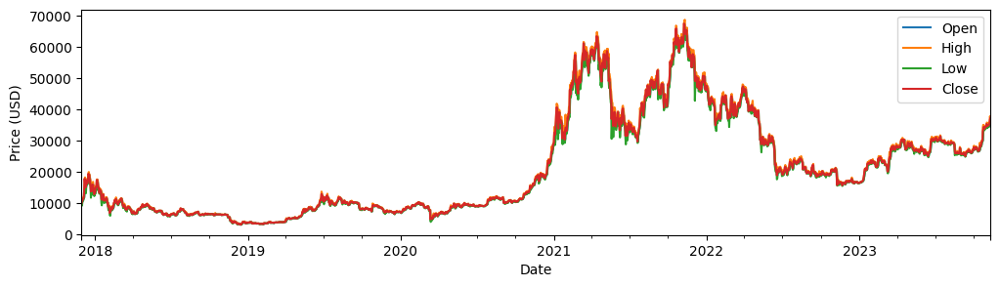

In [13]:
dataset.drop(columns=["Volume"]).plot()
plt.ylabel("Price (USD)")
plt.show()

Сейчас мы исследуем левую часть ряда, до 2021. Попробуем предсказать поведение цены, начиная с быстрых прикидок и заканчивая рекуррентной моделью.

Подготовим данные к формату `statsforecast`, и пока отложим дополнительные признаки (`df_exog`).

In [14]:
df = dataset.reset_index()
df = df.rename(columns={"Date": "ds", "Close": "y"})
df_exog = df[["ds", "Open", "High", "Low", "Volume"]]
df = df[["ds", "y"]]
df["unique_id"] = "id"

Разделим данные на обучение и валидацию. Выберем для работы участок последовательности с cхожим поведением.

In [15]:
start_date_train = "2019-01-01"
start_date_val = "2020-01-01"
start_date_test = "2020-06-01"
end_date_test = "2021-01-01"

def y_to_log(datasets):
  for dat in datasets:
    dat['y'] = np.log(dat['y'])
  return datasets
train_data = df[(df.ds >= start_date_train) & (df.ds < start_date_val)]
val_data = df[(df.ds >= start_date_val) & (df.ds < start_date_test)]
test_data = df[(df.ds >= start_date_test) & (df.ds < end_date_test)]
train_data,val_data,test_data = y_to_log([train_data,val_data,test_data])

/tmp/ipython-input-838206723.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dat['y'] = np.log(dat['y'])


In [16]:
train_data

,ds,y,unique_id
398,2019-01-01,8.254144,id
399,2019-01-02,8.279801,id
400,2019-01-03,8.252379,id
401,2019-01-04,8.257831,id
402,2019-01-05,8.254579,id
...,...,...,...
758,2019-12-27,8.894271,id
759,2019-12-28,8.898091,id
760,2019-12-29,8.912292,id
761,2019-12-30,8.894670,id


##SARIMA

Попробуем по целевому показателю предсказать на основе прошлых значений его будущие значения, т.е. будем работать с одномерным временным рядом.

Для модели выберем шаг в день (`freq='D'`).

In [28]:
sf = StatsForecast(models=[AutoARIMA(max_p=5, max_q=5, max_P=2, max_Q=2, stepwise=True, seasonal=True)], freq="D", n_jobs=-1)

sf = sf.fit(
    train_data,
    None,
    "unique_id",
    "ds",
    "y"

)


Предскажите вперёд на длину валидационной выборки, сохраните в `future_forecast`.

In [30]:
H_val = (pd.to_datetime(start_date_test) - pd.to_datetime(start_date_val)).days
future_forecast = sf.predict(H_val)

Визуализируйте результат:

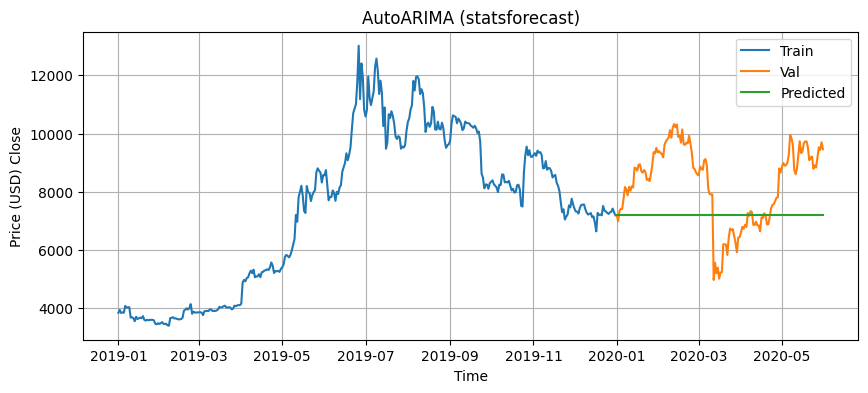

In [32]:
# Plotting
plt.figure(figsize=(10, 4))

plt.plot(train_data["ds"], np.exp(train_data["y"]), label="Train")
plt.plot(val_data["ds"], np.exp(val_data["y"]), label="Val")
plt.plot(future_forecast["ds"], np.exp(future_forecast["AutoARIMA"]), label="Predicted")

plt.title("AutoARIMA (statsforecast)")
plt.xlabel("Time")
plt.ylabel("Price (USD) Close")
plt.legend()
plt.grid(True)
plt.show()

Посчитайте RMSE на валидационных данных.

In [33]:
from sklearn.metrics import mean_squared_error

rmse = np.sqrt(
    mean_squared_error(
       np.exp(val_data['y']),
       np.exp(future_forecast['AutoARIMA'])
    )
)
print("RMSE: " + str(rmse))

RMSE: 1703.6421759466484


➕ Примем это решение за Baseline. Из плюсов — можно предсказывать на сколь угодно далеко в будущее (не факт, что качественно).

##SARIMAX

Попробуем воспользоваться оставшимися признаками, чтобы уточнить предсказание.

Теперь мы подаём не только `Y`, но и `X`, то есть добавляется регрессор.

Соберём данные обратно:

In [49]:
train_data_exog = train_data.merge(df_exog, how="left", on=["ds"])
val_data_exog = val_data.merge(df_exog, how="left", on=["ds"])
test_data_exog = test_data.merge(df_exog, how="left", on=["ds"])

In [50]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
def scale_exog_data(dataset,scaler,cols_to_scale,train=True):
  if train:
    dataset_scaled = scaler.fit_transform(dataset[cols_to_scale])
  else:
    dataset_scaled = scaler.transform(dataset[cols_to_scale])
  dataset[cols_to_scale] = pd.DataFrame(dataset_scaled, columns=cols_to_scale, index=dataset.index)
  return dataset
cols_to_scale = train_data_exog.loc[:, 'Open':].columns
train_data_exog = scale_exog_data(train_data_exog,scaler,cols_to_scale)
val_data_exog = scale_exog_data(val_data_exog,scaler,cols_to_scale,train=False)
test_data_exog = scale_exog_data(test_data_exog,scaler,cols_to_scale,train=False)

Подготовим валидационные данные:

In [51]:
val_y = val_data_exog["y"]
val_x = val_data_exog.drop(columns=["y"])

Разрешите подбор параметров в автоматическом режиме. Рекомендуем задать `stepwise=True` для оптимизации поиска.

In [52]:
sf = StatsForecast(
    models=[
        AutoARIMA(
            stepwise    = True,
            trace       = True,
            max_p       = 5,
            max_q       = 5,
            max_P       = 2,
            max_Q       = 2
        )
    ],
    freq="D",
    n_jobs=-1,
)

sf = sf.fit(
    train_data_exog,
    None,
    "unique_id",
    "ds",
    "y"
)


Regression with ARIMA(2,1,2) errors:-1892.5327398080442

Regression with ARIMA(0,1,0) errors:-1833.109748888003

Regression with ARIMA(1,1,0) errors:-1884.6480068509225

Regression with ARIMA(0,1,1) errors:-1894.684871864157

Regression with ARIMA(0,1,0) errors:-1834.1923034444062

Regression with ARIMA(1,1,1) errors:-1894.0415372332934

Regression with ARIMA(0,1,2) errors:-1894.4997268059853

Regression with ARIMA(1,1,2) errors:-1894.0483739630424

Regression with ARIMA(0,1,1) errors:-1894.0145783162645
Now re-fitting the best model(s) without approximations...


Regression with ARIMA(0,1,1) errors:-1894.684871864157


Предскажите вперёд на длину валидации, сохраните в `future_forecast`. Подайте признаки `val_x` как параметр `X_df` в `predict()`.

In [53]:
H_val = len(val_x['ds'].unique())
future_forecast = sf.predict(H_val,X_df = val_x)

Визуализируйте результат.

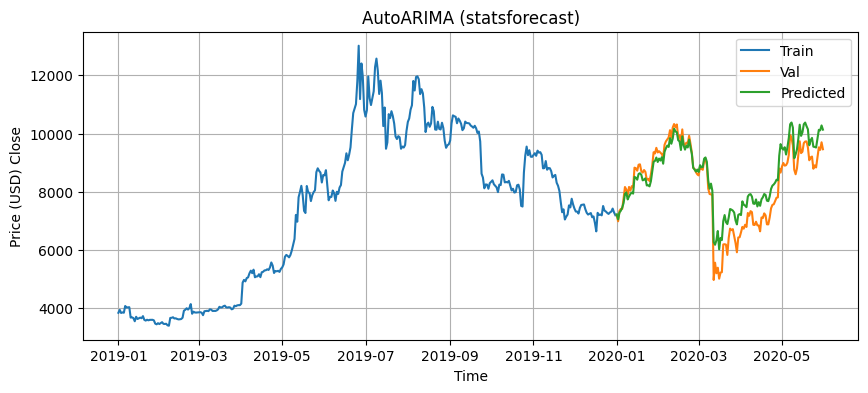

In [56]:
plt.figure(figsize=(10, 4))
plt.plot(train_data["ds"], np.exp(train_data["y"]), label="Train")
plt.plot(val_data["ds"], np.exp(val_data["y"]), label="Val")
plt.plot(future_forecast["ds"], np.exp(future_forecast["AutoARIMA"]), label="Predicted")

plt.title("AutoARIMA (statsforecast)")
plt.xlabel("Time")
plt.ylabel("Price (USD) Close")
plt.legend()
plt.grid(True)
plt.show()

Выведем параметры наилучшей модели.

In [57]:
model_summary = sf.models[0].__dict__
model_summary

{'d': None,
 'D': None,
 'max_p': 5,
 'max_q': 5,
 'max_P': 2,
 'max_Q': 2,
 'max_order': 5,
 'max_d': 2,
 'max_D': 1,
 'start_p': 2,
 'start_q': 2,
 'start_P': 1,
 'start_Q': 1,
 'stationary': False,
 'seasonal': True,
 'ic': 'aicc',
 'stepwise': True,
 'nmodels': 94,
 'trace': True,
 'approximation': False,
 'method': None,
 'truncate': None,
 'test': 'kpss',
 'test_kwargs': None,
 'seasonal_test': 'seas',
 'seasonal_test_kwargs': None,
 'allowdrift': True,
 'allowmean': True,
 'blambda': None,
 'biasadj': False,
 'season_length': 1,
 'alias': 'AutoARIMA',
 'prediction_intervals': None}

Посчитайте RMSE.

In [58]:
rmse = np.sqrt(
    mean_squared_error(
       np.exp(val_data['y']),
       np.exp(future_forecast['AutoARIMA'])
    )
)
print("RMSE: " + str(rmse))

RMSE: 551.6938511785074


Ошибка должна заметно уменьшится. С помощью относительно простой линейной модели мы можем получить приемлемое качество. Ещё одна фишка SARIMAX в том, что мы можем придумывать дополнительные признаки и подавать их в ту же модель, просто добавляя столбцы в таблице в `pandas`.

➕ Мы улучшили метрику. Однако не можем предсказывать будущие значения. Решение регрессионной задачи есть только там, где уже есть признаки.

##Нейросетевая модель

💥 Основная цель этой части — дать практику работы со сложным многомерными данными из реального мира. При неудачных параметрах качество предсказания модели может оказаться хуже, чем у SARIMAX. Если модель сможет грубо оценить поведение данных в будущем, этого уже достаточно. Дальнейшее улучшение — вопрос перебора параметров и машинного времени.

Воспользуемся нелинейной моделью. Адаптируем код из лекции для работы с многомерными данными.

Загрузим заново данные и поделим на подвыборки.

In [17]:
dataset = pd.read_csv("BTC-USD.csv", index_col="Date", parse_dates=True)
dataset.head(3)

,Open,High,Low,Close,Volume
Date,,,,,
2017-11-29,10077.400391,11517.400391,9601.030273,9888.610352,11568799744
2017-11-30,9906.790039,10801.000000,9202.049805,10233.599609,8310689792
2017-12-01,10198.599609,11046.700195,9694.650391,10975.599609,6783119872


### Разбиение на train-val-test

Выберем для работы участок последовательности со cхожим поведением.

In [18]:
start_date_train = "2019-01-01"
start_date_val = "2020-01-01"
start_date_test = "2020-06-01"
end_date_test = "2021-01-01"

train_data = dataset[
    (dataset.index >= start_date_train) & (dataset.index < start_date_val)
]
val_data = dataset[
    (dataset.index >= start_date_val) & (dataset.index < start_date_test)
]
test_data = dataset[
    (dataset.index >= start_date_test) & (dataset.index < end_date_test)
]

Для каждой части данных (train, val, и test) запишем в словарь временные метки и исходные данные.

In [19]:
split = {"train": {}, "val": {}, "test": {}}

for part, data_part in zip(split, [train_data, val_data, test_data]):
    split[part]["columns"] = data_part.columns
    split[part]["timestamps"] = data_part.index
    split[part]["data"] = data_part.values

Проверим размеры:

In [20]:
print(f'{split["train"]["data"].shape = }')
print(f'{split["val"]["data"].shape = }')
print(f'{split["test"]["data"].shape = }')

split["train"]["data"].shape = (365, 5)
split["val"]["data"].shape = (152, 5)
split["test"]["data"].shape = (214, 5)


Отобразим разделенные данные:

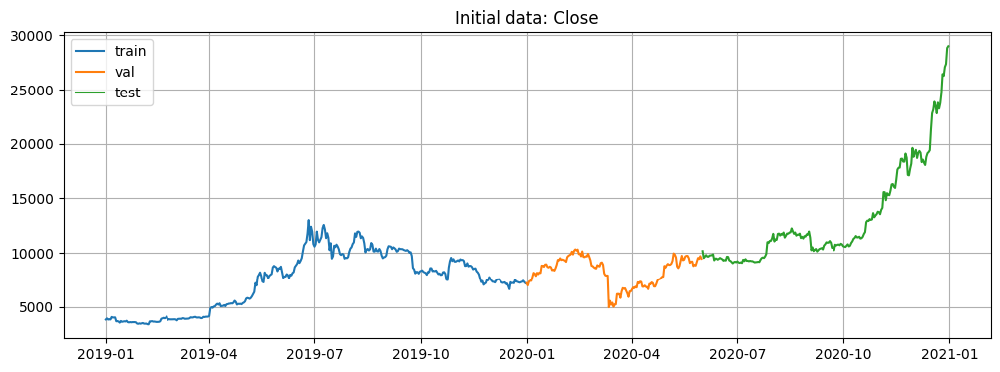

In [21]:
def initial_data_display(split, i=3):
    plt.figure(figsize=(12, 4))
    for part in split:
        plt.plot(split[part]["timestamps"], split[part]["data"][:, i], label=part)
    plt.title(f'Initial data: {split[part]["columns"][i]}')
    plt.legend()
    plt.grid()
    plt.show()


initial_data_display(split)

###Устранение тренда

In [22]:
from sklearn.linear_model import LinearRegression


class TimeSeriesTransform:
    def __init__(self, apply_log=False):
        self.slope = None
        self.apply_log = apply_log

    def fit(self, train_data: np.ndarray):
        data = train_data
        if self.apply_log:
            data = np.log(data + 1)

        x = np.arange(len(data))
        x_centered = x - x.mean()

        data_centered = data - data.mean(axis=0)


        slopes = []
        for i in range(data_centered.shape[1]):
            reg = LinearRegression(fit_intercept=False).fit(
                x_centered.reshape(-1, 1), data_centered[:, i].reshape(-1, 1)
            )
            slopes.append(reg.coef_[0])

        self.slope = slopes

        return self

    def transform(self, data: np.ndarray, window_size: int):
        if self.slope is None:
            raise ValueError("call fit before transform")

        if self.apply_log:
            data = np.log(data + 1)

        x = np.arange(len(data))
        x_centered = x - x.mean()
        trend = self.slope * x_centered

        anchor_value = data[window_size]
        data_centered = data - data.mean(axis=0)
        data_detrended = data_centered - trend.T
        return anchor_value, data_detrended

    def inverse_transform(self, anchor_value: float, data_detrended: np.ndarray):
        if self.slope is None:
            raise ValueError("call fit before inverse_transform")

        x = np.arange(len(data_detrended))
        x_centered = x - x.mean()
        trend = self.slope * x_centered

        trend = trend.T
        data = np.squeeze(data_detrended) + trend

        data = (
            data
            - np.array([data[0, :]] * len(data))
            + np.array([anchor_value] * len(data))
        )
        if self.apply_log:
            data = np.exp(data) - 1
        return data

Сохраним опорные точки (`anchor_value`) для каждой из подвыборок, чтобы знать, в каком масштабе нужно добавлять тренд в дальнейшем при вызове `inverse_transform`.

In [23]:
window_size = 30
split["train"]["transform"] = TimeSeriesTransform(apply_log=True)

split["train"]["transform"].fit(split["train"]["data"])

for part in split:
    split[part]["anchor_value"], split[part]["data_transformed"] = split["train"][
        "transform"
    ].transform(split[part]["data"], window_size=window_size)

Отобразим преобразованные данные, на которых теперь можно обучать, валидировать и тестировать нейронную сеть:

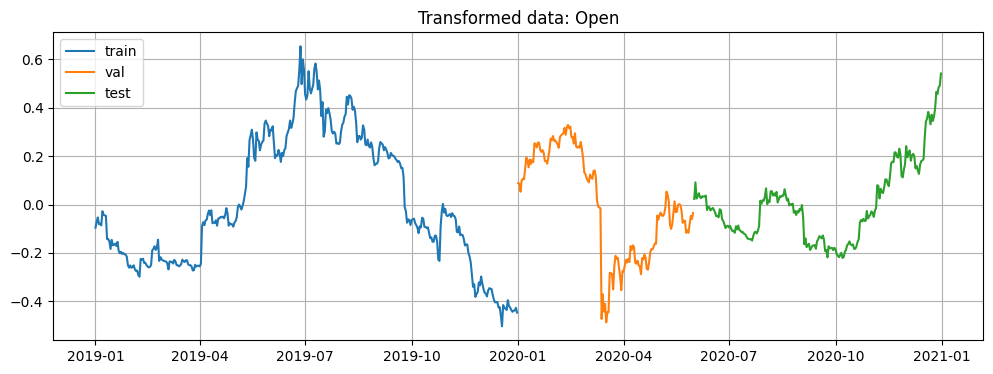

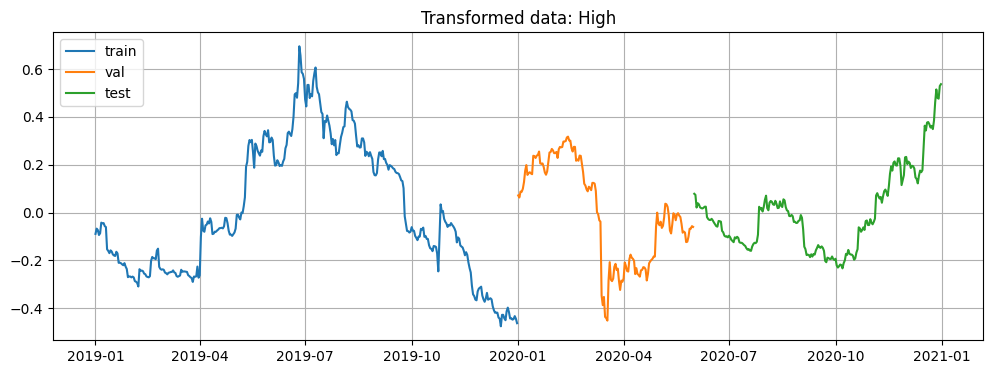

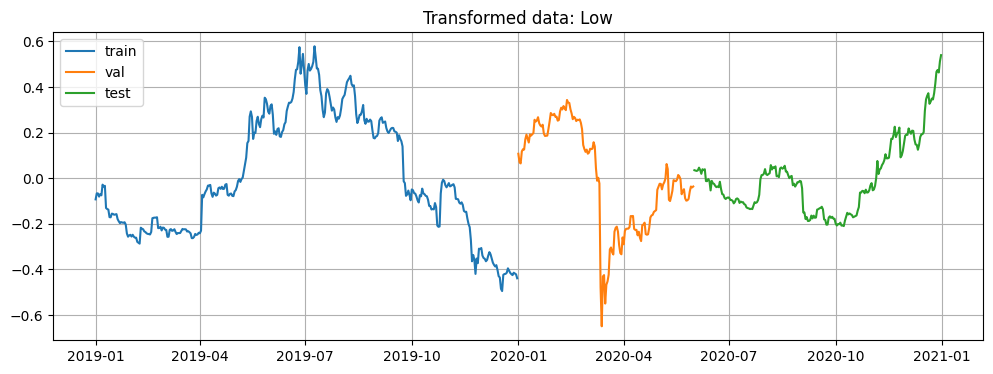

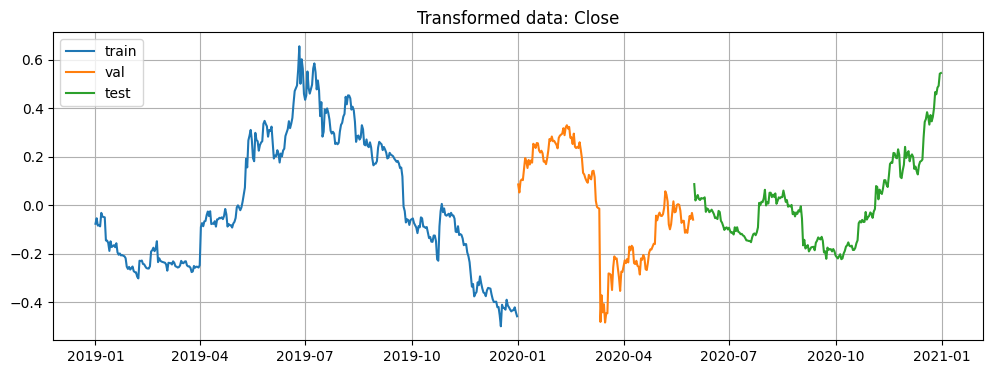

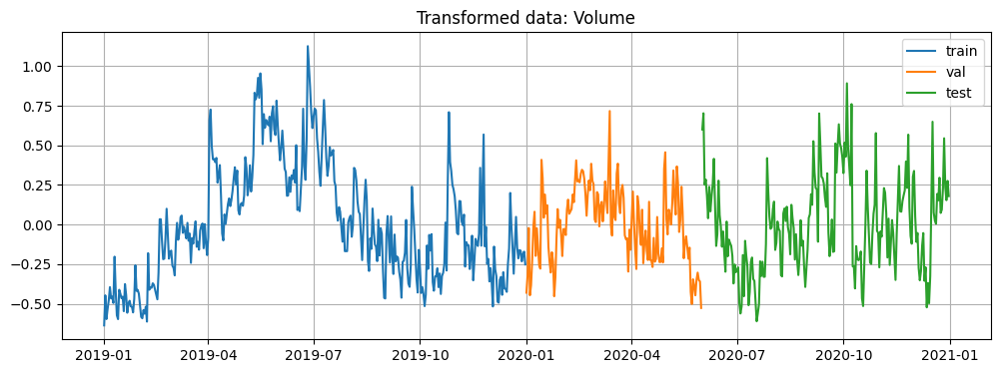

In [24]:
def transformed_data_display(split):
    for i in range(5):
        plt.figure(figsize=(12, 4))
        for part in split:
            plt.plot(
                split[part]["timestamps"],
                split[part]["data_transformed"][:, i],
                label=part,
            )
        plt.title(f'Transformed data: {split[part]["columns"][i]}')
        plt.legend()
        plt.grid()
        plt.show()


transformed_data_display(split)

In [26]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
split["train"]["data_transformed"] = scaler.fit_transform(split["train"]["data_transformed"])
split["val"]["data_transformed"] = scaler.transform(split["val"]["data_transformed"])
split["test"]["data_transformed"] = scaler.transform(split["test"]["data_transformed"])


###Создание датасета

Создадим датасет: будем обучать нейронную сеть по последовательности из `seq_len` элементов предсказывать `seq_len + 1`-й.

In [27]:
from torch.utils.data import Dataset
class TimeSeriesDataset(Dataset):
    def __init__(self, data, seq_length):
        super().__init__()
        self.seq_length = seq_length
        self.data = torch.from_numpy(data).float()

    def __getitem__(self, idx):
        x = self.data[idx : (idx + self.seq_length)]
        y = self.data[idx + self.seq_length]
        return x, y

    def __len__(self):
        return len(self.data) - self.seq_length

Для каждой части данных создадим `DataSet` и `DataLoader`:

In [28]:
from torch.utils.data import DataLoader

for part in split:
    split[part]["dataset"] = TimeSeriesDataset(
        data=split[part]["data_transformed"], seq_length=window_size
    )

    shuffle = True if part == "train" else False

    split[part]["dataloader"] = DataLoader(
        dataset=split[part]["dataset"], batch_size=16, shuffle=shuffle
    )

Проверим размеры и количество батчей во всех подвыборках:

In [29]:
for par in split:
  print(par)
  x, y = next(iter(split[par]["dataloader"]))

  print(f"one batch input shape:   {x.shape}")
  print(f"one batch output shape:  {y.shape}")
  print(f"number of train batches: {len(split[par]['dataloader'])}")


train
one batch input shape:   torch.Size([16, 30, 5])
one batch output shape:  torch.Size([16, 5])
number of train batches: 21
val
one batch input shape:   torch.Size([16, 30, 5])
one batch output shape:  torch.Size([16, 5])
number of train batches: 8
test
one batch input shape:   torch.Size([16, 30, 5])
one batch output shape:  torch.Size([16, 5])
number of train batches: 12


###Создание модели

Рекомендуем использовать модель LSTM.

Здесь вы сможете попробовать сделать вашу модель более мощной, так как данные усложнились. Учтите, что вы предсказываете 1 точку вперёд за раз, но теперь ряд многомерный (проверьте размер выхода нейросети).

In [30]:
import torch.nn as nn

class TimeSeriesPredictor(nn.Module):
    def __init__(
        self, input_size=5,
        hidden_size=512,
        num_layers=3,
        dropout= 0.2,
        output_size = 5,
    ):
        super().__init__()
        self.lstm = nn.LSTM(input_size, hidden_size, num_layers, batch_first=True,dropout = dropout,bidirectional=True)
        self.activation = nn.ReLU()
        self.fc1 = nn.Linear(hidden_size*2, hidden_size)
        self.bn = nn.BatchNorm1d(hidden_size)
        self.fc2 = nn.Linear(hidden_size, output_size)

    def forward(self, x):
        lstm_out, _ = self.lstm(x)
        out = self.bn(self.fc1(lstm_out[:, -1, :]))
        out = self.activation(out)
        out = self.fc2(out)
        return out

Проверим, что входные данные одного батча проходят через модель.

In [31]:
model = TimeSeriesPredictor()
out = model(x)

print(f"Model output size: {out.shape} [bach_size, elements]")

Model output size: torch.Size([16, 5]) [bach_size, elements]


###Получение предсказаний

In [32]:
def forced_predict(model, split, part,device = device):
    y_true = []
    y_pred = []
    model.to(device)
    model.eval()
    dataset = split[part]["dataset"]
    with torch.no_grad():
        for x, y in dataset:
            out = model(x.unsqueeze(0).to(device)).detach().cpu()
            y_true.append(y.tolist())
            y_pred.append(out.tolist())
    y_true = np.array(y_true)
    y_pred = np.array(y_pred)

    transform = split["train"]["transform"]
    y_true = transform.inverse_transform(split[part]["anchor_value"], y_true)
    y_pred = transform.inverse_transform(split[part]["anchor_value"], y_pred)

    return y_true, y_pred

In [33]:
def rolling_predict(model, split, part, forecast_horizon):
    y_pred = []
    model.eval()
    model.to(device)
    dataset = split[part]["dataset"]
    x, _ = dataset[0]

    with torch.no_grad():
        for _ in range(forecast_horizon):
            out = model(x.unsqueeze(0).to(device)).detach().cpu().view(-1, 1)
            y_pred.append(out.tolist())
            x = torch.cat([x[1:, :], out.T], dim=0)
    y_pred = np.array(y_pred)

    transform = split["train"]["transform"]
    y_pred = transform.inverse_transform(split[part]["anchor_value"], y_pred)

    return y_pred

Для проверки получим предсказания необученной модели: в режиме "forced prediction" для обучающих и валидационных данных и в режиме "rolling prediction" для тестовых.

In [34]:
for part in split:
    if part in ("train", "val"):
        y_true, y_pred = forced_predict(model, split, part)

    if part == "test":
        y_true, _ = forced_predict(model, split, part)
        y_pred = rolling_predict(model, split, part, forecast_horizon=len(y_true))

    split[part]["y_true"] = y_true
    split[part]["y_pred"] = y_pred

Отобразим актуальные и предсказанные данные.

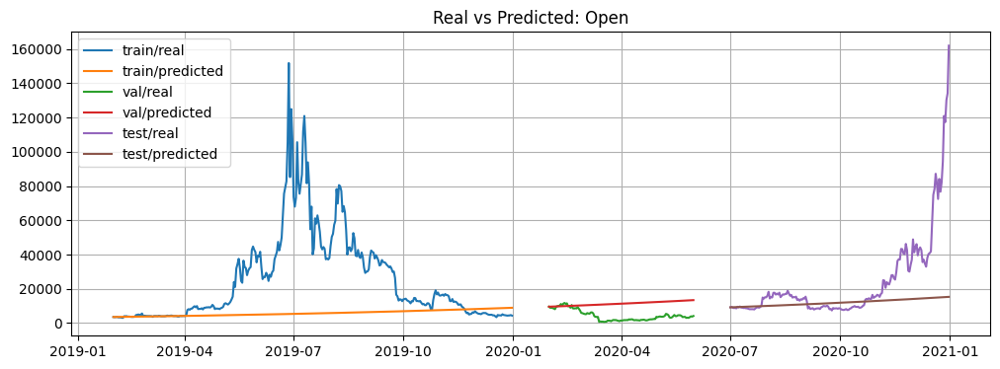

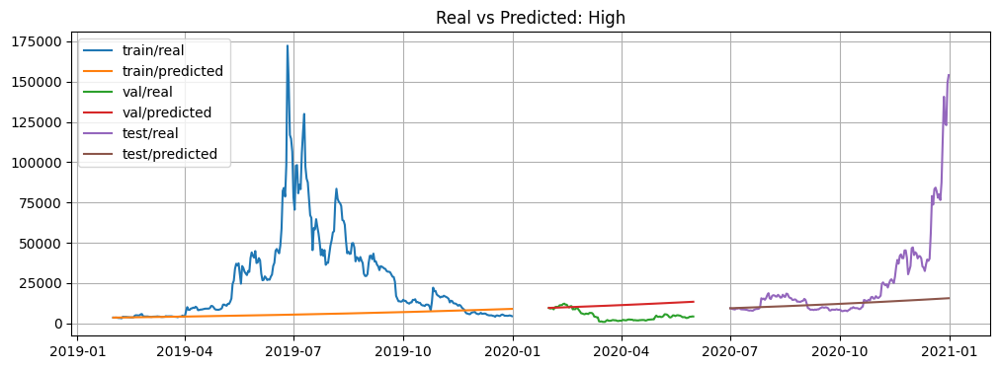

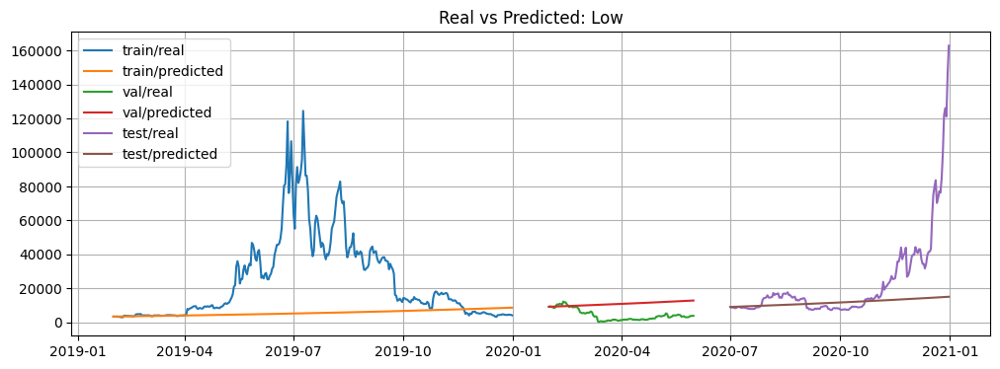

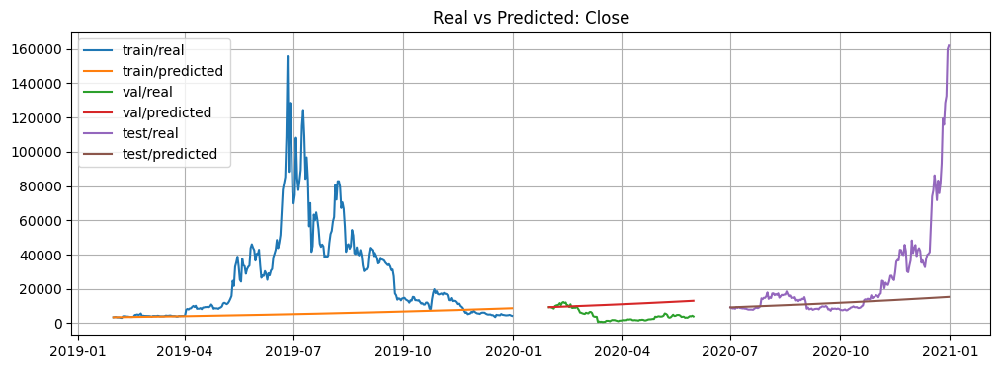

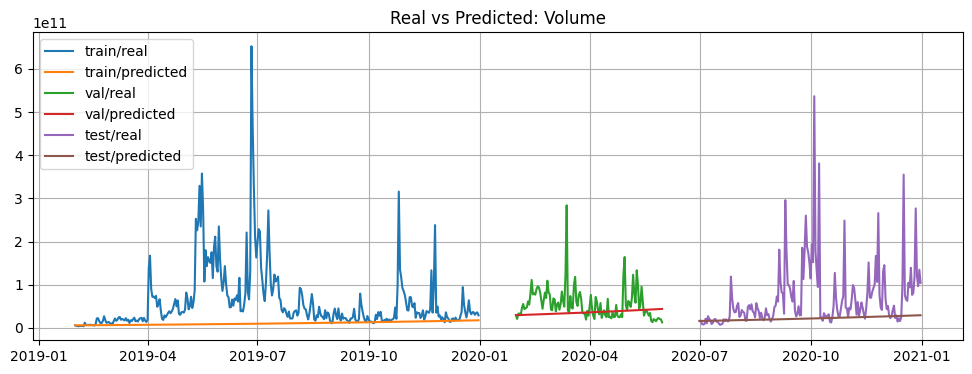

In [35]:
from datetime import timedelta


def display_pred_with_rolling_test(
    split, show_only_target=False, post_test=False, dataset=dataset
):
    for i in range(5):
        plt.figure(figsize=(12, 4))
        if show_only_target:
            i = 3
        for part in split:
            timestamps = split[part]["timestamps"][window_size:]
            real_data = split[part]["y_true"][:, i]
            pred_data = split[part]["y_pred"][:, i]

            if part in ("train", "val"):

                plt.plot(timestamps, real_data, label=f"{part}/real")
                plt.plot(timestamps, pred_data, label=f"{part}/predicted")

            if part == "test":
                plt.plot(timestamps, real_data, label=f"{part}/real")

                future_timestamps = pd.date_range(
                    timestamps[0],
                    timestamps[0] + timedelta(days=(len(pred_data)) - 1),
                    freq="D",
                )
                plt.plot(future_timestamps, pred_data, label=f"{part}/predicted")


        if post_test:
            future_timestamps = pd.date_range(
                timestamps[-1],
                timestamps[-1] + timedelta(days=(len(pred_data))),
                freq="D",
            )
            furure_data = dataset["Close"][
                timestamps[-1] : timestamps[-1] + timedelta(days=(len(pred_data)))
            ]
            plt.plot(future_timestamps, furure_data, label="real future data")

        plt.title(f'Real vs Predicted: {split[part]["columns"][i]}')
        plt.legend()
        plt.grid()
        plt.show()
        if show_only_target:
            return  # show Close column


display_pred_with_rolling_test(split)

Оценим ошибку RMSE для предсказаний необученной модели (только для целевой переменной).

In [36]:
from sklearn.metrics import root_mean_squared_error

for part in split:
    part_rmse = np.sqrt(
        root_mean_squared_error(
            y_true=split[part]["y_true"],
            y_pred=split[part]["y_pred"],
        )
    )
    print(f"{part:<5} RMSE: {part_rmse:.2f}")

train RMSE: 132806.41
val   RMSE: 91088.25
test  RMSE: 131291.57


###Обучение

In [37]:
import lightning as L
from torchmetrics import MetricCollection
from torchmetrics.regression import MeanSquaredError


class TimeSeriesPipeline(L.LightningModule):
    def __init__(
        self,
        model,
        exp_name="baseline",
        criterion=nn.MSELoss(),
        optimizer_class=torch.optim.AdamW,
        lr = 1e-4
    ):
        super().__init__()
        self.model = model
        self.criterion = criterion
        self.optimizer_class = optimizer_class
        metrics = MetricCollection([MeanSquaredError()])
        self.train_metrics = metrics.clone(postfix="/train")
        self.valid_metrics = metrics.clone(postfix="/val")
        self.lr = lr

    def configure_optimizers(self):
        optimizer = self.optimizer_class(self.model.parameters(),lr = self.lr)
        return optimizer

    def training_step(self, batch, batch_idx):
        x, y = batch
        out = self.model(x)
        loss = self.criterion(out, y)
        self.log("Loss/train", loss, prog_bar=True)
        self.train_metrics.update(out, y)

        return loss

    def validation_step(self, batch, batch_idx):
        x, y = batch
        y = torch.squeeze(y)
        out = self.model(x)
        loss = self.criterion(out, y)
        self.log("Loss/val", loss, prog_bar=True)
        self.valid_metrics.update(out, y)

    def on_training_epoch_end(self):
        train_metrics = self.train_metrics.compute()
        self.log_dict(train_metrics)
        self.train_metrics.reset()

    def on_validation_epoch_end(self):
        valid_metrics = self.valid_metrics.compute()
        self.log_dict(valid_metrics)
        self.valid_metrics.reset()

In [41]:
%load_ext tensorboard
%tensorboard --logdir logs/ex_timeseries/ --port 6009

Output hidden; open in https://colab.research.google.com to view.

Создадим пайплайн и запустим обучение с сохранением лучшей модели по минимальному MSE на валидационной выборке.

In [40]:
L.seed_everything(42)

checkpoint_callback = ModelCheckpoint(
    monitor="MeanSquaredError/val", mode="min", filename="best"
)

exp_name = f"baseline"
trainer = Trainer(
    max_epochs=1000,
    logger=TensorBoardLogger(save_dir=f"logs/ex_timeseries", name=exp_name),
    num_sanity_val_steps=1,
    callbacks=[checkpoint_callback],
    log_every_n_steps=10,
    enable_progress_bar=True,
)

model = TimeSeriesPredictor()


pipeline = TimeSeriesPipeline(
    model=model,
    optimizer_class=torch.optim.AdamW,
    lr=1e-3
)

trainer.fit(
    model=pipeline,
    train_dataloaders=split["train"]["dataloader"],
    val_dataloaders=split["val"]["dataloader"],
)

INFO: Seed set to 42
INFO:lightning.fabric.utilities.seed:Seed set to 42
INFO: GPU available: True (cuda), used: True
INFO:lightning.pytorch.utilities.rank_zero:GPU available: True (cuda), used: True
INFO: TPU available: False, using: 0 TPU cores
INFO:lightning.pytorch.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO: HPU available: False, using: 0 HPUs
INFO:lightning.pytorch.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO: 
  | Name          | Type                | Params | Mode 
--------------------------------------------------------------
0 | model         | TimeSeriesPredictor | 15.3 M | train
1 | criterion     | MSELoss             | 0      | train
2 | train_metrics | MetricCollection    | 0      | train
3 | valid_metrics | MetricCollection    | 0      | train
--------------------------------------------------------------

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO: `Trainer.fit` stopped: `max_epochs=1000` reached.
INFO:lightning.pytorch.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=1000` reached.


#### Восстановление модели из контрольной точки

In [42]:
checkpoint = torch.load("logs/ex_timeseries/baseline/version_0/checkpoints/best.ckpt",map_location = 'cpu')

In [43]:
checkpoint["state_dict"].keys()

odict_keys(['model.lstm.weight_ih_l0', 'model.lstm.weight_hh_l0', 'model.lstm.bias_ih_l0', 'model.lstm.bias_hh_l0', 'model.lstm.weight_ih_l0_reverse', 'model.lstm.weight_hh_l0_reverse', 'model.lstm.bias_ih_l0_reverse', 'model.lstm.bias_hh_l0_reverse', 'model.lstm.weight_ih_l1', 'model.lstm.weight_hh_l1', 'model.lstm.bias_ih_l1', 'model.lstm.bias_hh_l1', 'model.lstm.weight_ih_l1_reverse', 'model.lstm.weight_hh_l1_reverse', 'model.lstm.bias_ih_l1_reverse', 'model.lstm.bias_hh_l1_reverse', 'model.lstm.weight_ih_l2', 'model.lstm.weight_hh_l2', 'model.lstm.bias_ih_l2', 'model.lstm.bias_hh_l2', 'model.lstm.weight_ih_l2_reverse', 'model.lstm.weight_hh_l2_reverse', 'model.lstm.bias_ih_l2_reverse', 'model.lstm.bias_hh_l2_reverse', 'model.fc1.weight', 'model.fc1.bias', 'model.bn.weight', 'model.bn.bias', 'model.bn.running_mean', 'model.bn.running_var', 'model.bn.num_batches_tracked', 'model.fc2.weight', 'model.fc2.bias'])

In [44]:
state_dict = {}
for key in checkpoint["state_dict"].keys():
    key_new = key[len('model.'):]
    state_dict[key_new] = checkpoint["state_dict"][key]

model = TimeSeriesPredictor()
model.load_state_dict(state_dict)

<All keys matched successfully>

## Предсказания обученной модели

Получим и отобразим предсказания обученной модели: в режиме "forced prediction" для обучающих и валидационных данных и в режиме "rolling prediction" для тестовых.

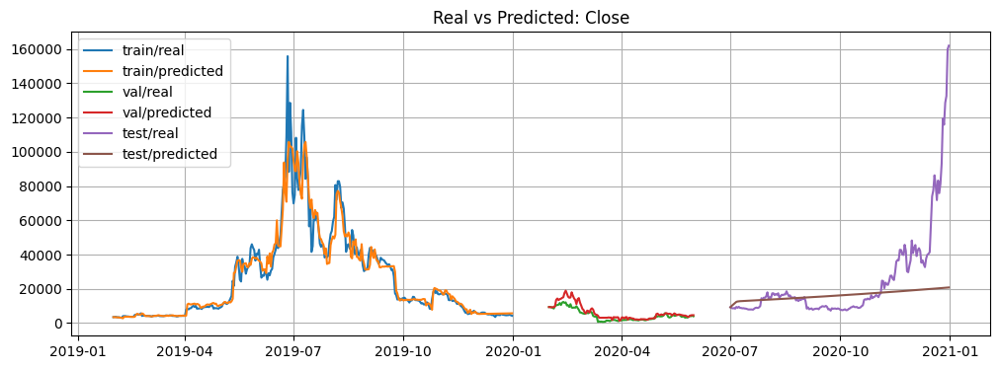

In [45]:
for part in split:
    if part in ("train", "val"):
        y_true, y_pred = forced_predict(model, split, part)

    if part == "test":
        y_true, _ = forced_predict(model, split, part)
        y_pred = rolling_predict(model, split, part, forecast_horizon=len(y_true))

    split[part]["y_true"] = y_true
    split[part]["y_pred"] = y_pred

display_pred_with_rolling_test(split, show_only_target=True)

Посчитайте RMSE для целевой переменной.

In [46]:
for part in split:
    part_rmse = np.sqrt(
        root_mean_squared_error(
            y_true=split[part]["y_true"],
            y_pred=split[part]["y_pred"],
        )
    )
    print(f"{part:<5} RMSE: {part_rmse:.2f}")

train RMSE: 117238.69
val   RMSE: 105935.13
test  RMSE: 122098.65


В режиме "rolling prediction" должен быть предсказан восходящий тренд.

Также проверим предсказания в режиме "rolling prediction" для обучающих, валидационных и тестовых данных.

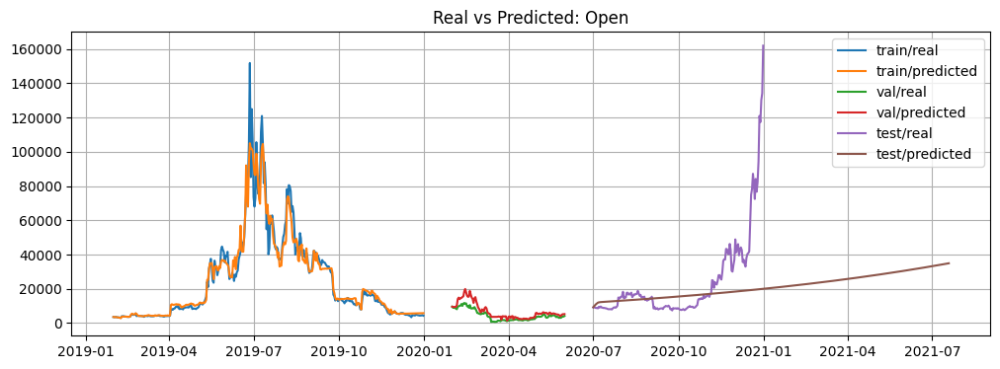

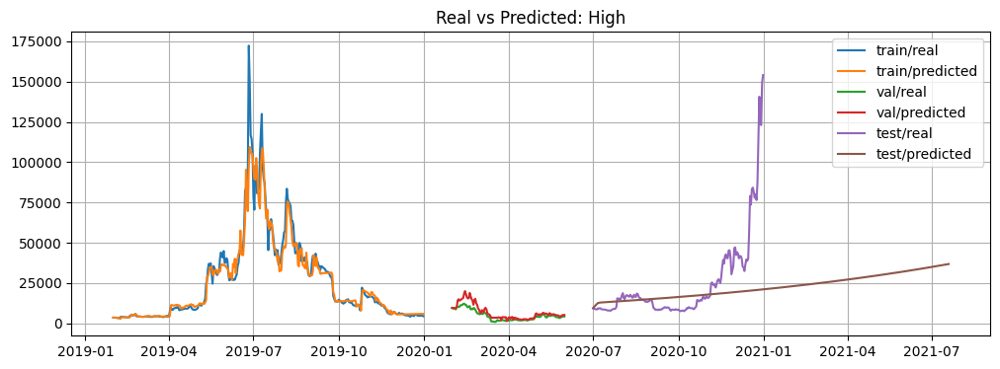

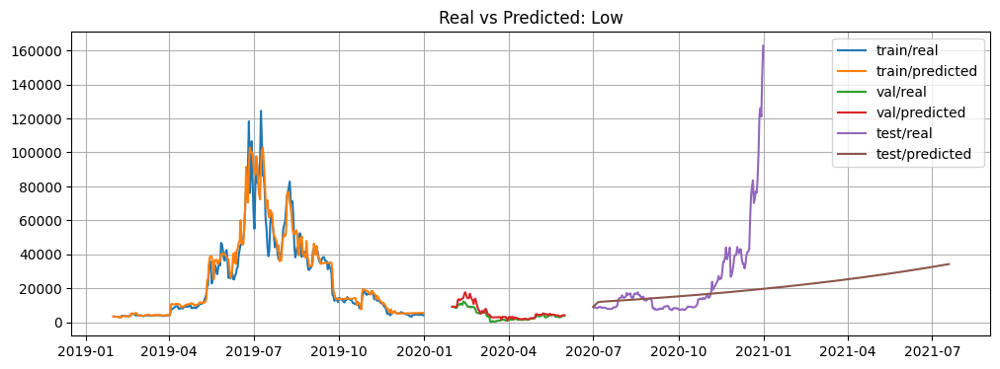

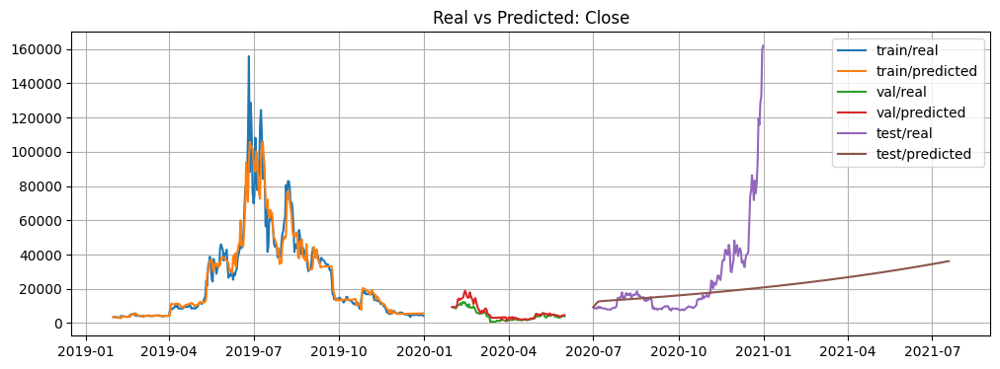

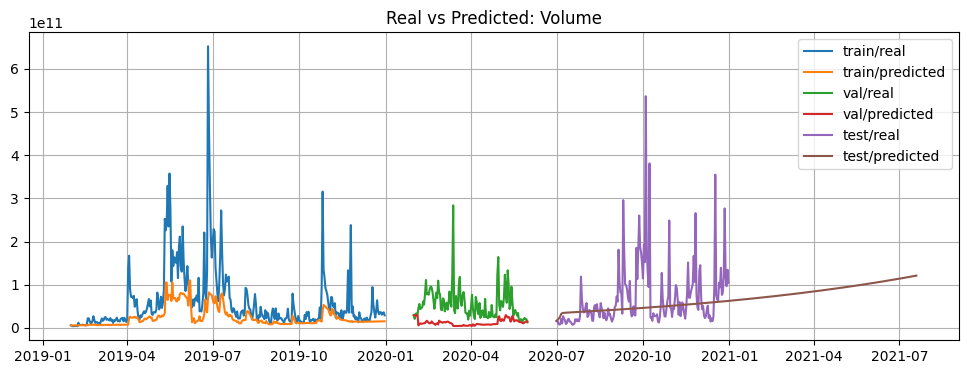

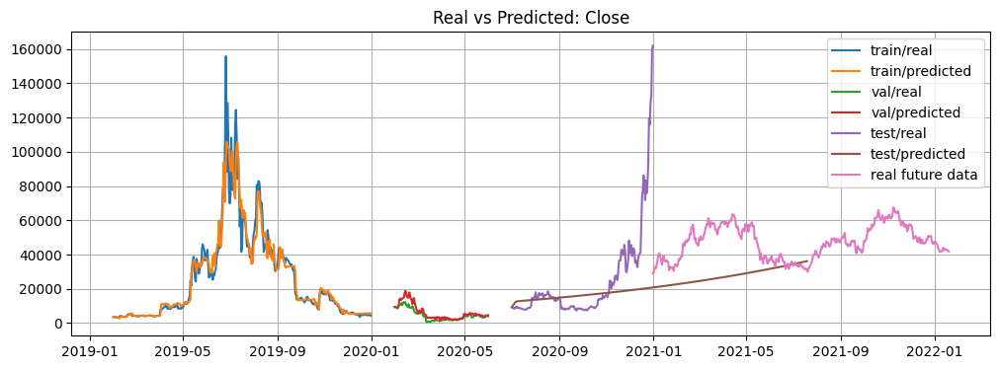

In [47]:
predict_next = 200
for part in split:
    if part in ("train", "val"):
        y_true, y_pred = forced_predict(model,split,part)

    if part == "test":
        y_true, _ = forced_predict(model, split, part)
        y_pred = rolling_predict(model, split,part,forecast_horizon=len(y_true)+predict_next)

    split[part]["y_true"] = y_true
    split[part]["y_pred"] = y_pred

display_pred_with_rolling_test(split)

display_pred_with_rolling_test(
    split, show_only_target=True, post_test=True, dataset=dataset
)

Для того, чтобы улучшить качество предсказания, можно сделать более сложную модель (размер вектора hidden в рекуррентном слое, количество таких слоёв, дополнительные линейные слои, тип оптимизатора).

Главная сложность в самих данных, которые меняют своё поведение во времени. Сильно и внезапно.

Получилась не очень хорошо :(. 3 слоя LSTM + пара линейный слоев + AdamW не улучшили ситуацию.


**Выводы:**

1. SARIMA используется в качестве baseline.
2. SARIMAX предсказывает неплохо, но только там, где есть признаки. Для предсказания дальше нужно снова возвращаться к SARIMA (или реализовывать цикл, SARIMA будет каждый раз переобучаться на новые, предсказанные данные).
3. Нейросеть работает на любом промежутке времени, но сложность разработки может быть крайне высокой.